In [ ]:
import pandas as pd
import numpy as np
import json
import os
import matplotlib.pyplot as plt
from matplotlib_venn import venn2
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, accuracy_score, mean_absolute_error, mean_squared_error
from pingouin import intraclass_corr
import scipy.stats as st


#### Projeto Integrador IV
Notebook modificado do original usado no paper para fins de desenvolver o Projeto Integrador IV da Univesp.

Os objetivos são os seguintes:
1. Melhorar a UX do dashboard (scoreboard.py) para que as matérias de direito sejam colunas em vez de linhas.
2. Melhorar o modelo de regressão para estimar o desempenho do candidato na segunda fase.

In [2]:
df_maritaca_discursive = pd.read_pickle('df_evaluations_discursive_sabiazinho3.pkl')
df_maritaca_document_writing = pd.read_pickle('df_evaluations_document_writing_sabiazinho3.pkl')
df_gpt_discursive = pd.read_pickle('df_evaluations_discursive.pkl')
df_gpt_document_writing = pd.read_pickle('df_evaluations_document_writing_gpt.pkl')
df_gpt_discursive_41 = pd.read_pickle('df_evaluations_discursive_gpt_41.pkl')
df_gpt_document_writing_41 = pd.read_pickle('df_evaluations_document_writing_gpt_41.pkl')
df_gpt_discursive_o3_mini = pd.read_pickle('df_evaluations_discursive_gpt_o3_mini.pkl')
df_gpt_document_writing_o3_mini = pd.read_pickle('df_evaluations_document_writing_gpt_o3_mini.pkl')

De início, vamos explorar se tudo correu OK na extração.

In [3]:
df_gpt_discursive_o3_mini.sample(2)

,answer_id,exam,exam_date,number,area,question,answer,criteria,formated_criteria,model_answer,judge_model,judge_number,evaluation,experiment,input_tokens,output_tokens
623,41,40,2024-05-19,1,tributário,Para o enfrentamento de uma nova pandemia ocor...,"A) Sim, é válida a previsão de imediata cobran...",A. Sim. O empréstimo compulsório para atender ...,"[{'letra': 'A', 'parte': 'I', 'gabarito': 'Sim...","[{""A"": ""N\u00e3o, a previs\u00e3o de imediata ...",gpto3-mini,3,"{'resultado': [{'letra': 'A', 'parte': 'I', 'g...",1,1719,2582
2850,67,39,2024-01-21,3,constitucional,Um grupo de senadores apresentou projeto de le...,A) Não. Trata-se de matéria de iniciativa legi...,A. Não. Trata-se de matéria de iniciativa legi...,"[{'letra': 'A', 'parte': 'I', 'gabarito': 'Não...","[{""A"": ""Sim, o grupo de senadores tinha legiti...",gpto3-mini,0,"{'resultado': [{'letra': 'A', 'parte': 'I', 'g...",6,1358,3656


questões discursivas

In [4]:
assert len(df_gpt_discursive) == len(df_gpt_discursive_41) == len(df_maritaca_discursive) 
print(len(df_gpt_discursive))

8400


questões de prática profissional para escrita de documentos jurídicos

In [5]:
assert len(df_gpt_document_writing) == len(df_gpt_document_writing_41) == len(df_maritaca_document_writing)
print(len(df_gpt_document_writing))

2100


In [6]:
df_discursive = pd.concat([df_gpt_discursive,df_gpt_discursive_41, df_maritaca_discursive, df_gpt_discursive_o3_mini])
#df_discursive.to_pickle('./data/df_reference_evaluations_discursive.pkl')
df_document_writing = pd.concat([df_gpt_document_writing,df_gpt_document_writing_41, df_maritaca_document_writing, df_gpt_document_writing_o3_mini ])
#df_document_writing.to_pickle('./data/df_reference_evaluations_document_writing.pkl')

Fizemos 10 experimentos com 5 julgadores em 6 modelos, sobre 84 questões discursivas e 21 escritas de documentos. Vamos ver o quanto isso varia.

In [7]:
def score_individual_discursive_question(evaluation):
    right_questions = 0
    score = 0
    right_questions_list = []
    score_list = []
    for line in evaluation:
        #print(line)

        if line['acerto'] == 1:
            right_questions = right_questions + 1
            score = score + line['pontos']
            right_questions_list.append(1)
            score_list.append(line['pontos'])
        else:
            right_questions_list.append(0)
            score_list.append(0)
    return right_questions, right_questions_list, score, score_list

In [8]:
ix = 10
evaluation = df_discursive.iloc[ix].evaluation
score_individual_discursive_question(evaluation)

(1, [0, 0, 1, 0], 0.55, [0, 0, 0.55, 0])

Como a nota final na mesma prova varia por modelo?

In [9]:
exam = 40
area = 'civil'
models = df_discursive['judge_model'].unique()

df_model_scores = pd.DataFrame(columns=['model','scores'])

try:
    for model in models:
        model_scores  = []
        print(f'Evaluation {model}')
        for experiment in range(0,10):
             for judge in range(0,5):
                exam_score = 0
                for number in range(1,5):
                    for ix, row in df_discursive.query('exam == @exam & area == @area & judge_model == @model & number == number & judge_number == @judge & experiment == @experiment').iterrows():
                        evaluation = row.evaluation
                        if 'resultado' in evaluation:
                            evaluation = evaluation['resultado']
                        #print(evaluation)
                        # treatment to points
                        if 'pontos' not in evaluation[0]: #so the we need to take the scoring points in reference 
                            for e in evaluation:
                                e_letra = e['letra']
                                e_parte = e['parte']
                                #now we need to find this question in reference
                                for c in row.formated_criteria:
                                    c_letra = c['letra']
                                    c_parte = c['parte']
                                    if e_letra == c_letra and e_parte == c_parte:
                                        #ok, we found the match, so we need to extract the points
                                        e['pontos'] = c['pontos']
                        right_questions, right_questions_list, score, score_list = score_individual_discursive_question(evaluation)
                        #print(score)
                        exam_score = exam_score + score
                model_scores.append(exam_score)
        print(f'Scores {model_scores}')
        df_model_scores = pd.concat([df_model_scores,pd.DataFrame({'model':model, 'scores':model_scores})], ignore_index=True)
except Exception as e:
    print('ERRO ',e)
    

Evaluation gpt4o-mini
Scores [14.600000000000003, 14.000000000000004, 14.8, 12.400000000000002, 14.8, 14.400000000000004, 15.000000000000004, 14.600000000000003, 14.000000000000004, 14.8, 14.600000000000003, 14.200000000000005, 17.000000000000004, 16.000000000000004, 14.8, 14.8, 14.200000000000005, 15.200000000000001, 14.400000000000004, 14.000000000000004, 14.000000000000004, 14.8, 14.000000000000004, 14.600000000000005, 14.600000000000001, 14.000000000000004, 15.000000000000004, 14.000000000000004, 14.000000000000004, 14.000000000000004, 12.000000000000002, 14.8, 14.400000000000002, 12.000000000000002, 15.000000000000004, 14.400000000000002, 14.600000000000003, 14.600000000000005, 14.000000000000004, 14.400000000000002, 14.000000000000004, 14.400000000000002, 14.600000000000001, 14.8, 14.200000000000001, 14.8, 14.200000000000005, 14.000000000000004, 14.8, 14.000000000000004]
Evaluation gpt4o


/tmp/ipykernel_37476/3534921965.py:37: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_model_scores = pd.concat([df_model_scores,pd.DataFrame({'model':model, 'scores':model_scores})], ignore_index=True)


Scores [13.8, 13.8, 13.400000000000002, 13.400000000000002, 13.400000000000002, 13.400000000000002, 12.200000000000001, 13.8, 13.8, 13.400000000000002, 13.8, 12.600000000000001, 11.799999999999997, 13.400000000000002, 13.8, 13.400000000000002, 12.6, 12.6, 13.8, 13.400000000000002, 12.200000000000001, 12.600000000000001, 13.400000000000002, 12.200000000000001, 12.200000000000001, 12.600000000000001, 12.600000000000001, 13.8, 13.400000000000002, 13.8, 12.200000000000001, 12.200000000000001, 12.200000000000001, 13.400000000000002, 12.200000000000001, 13.400000000000002, 13.400000000000002, 13.400000000000002, 12.6, 12.200000000000001, 13.400000000000002, 12.200000000000001, 13.400000000000002, 13.8, 13.400000000000002, 13.400000000000002, 13.400000000000002, 12.200000000000001, 12.6, 13.8]
Evaluation gpt41-mini
Scores [13.2, 12.8, 13.2, 13.2, 11.999999999999996, 13.2, 12.999999999999996, 11.999999999999996, 11.999999999999996, 12.399999999999997, 11.999999999999996, 13.2, 13.2, 12.8, 11.9

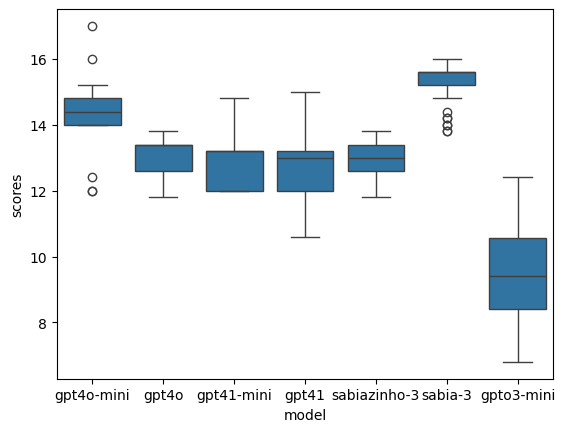

In [12]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.boxplot(data=df_model_scores, x='model',y='scores')
plt.show()

Vamos trabalhar com as respostas dadas pelos humanos.

Fizemos anotações com 3 humanos sobre as respostas de um modelo na segunda fase ( questões abertas). Vamos agora desempacotar estas respostas para ver o quanto dá de concordância e divergência e o quanto dá na nota.

In [ ]:

# Caminho da pasta onde estão os arquivos de anotações
folder_path = "./data/"
file1_path = os.path.join(folder_path, "humano1_anotacoes_discursivas.json")
file2_path = os.path.join(folder_path, "humano2_anotacoes_discursivas.json")
file3_path = os.path.join(folder_path, "humano3_anotacoes_discursivas.json")

# Função para carregar as anotações
def load_annotations(file_path):
    with open(file_path, "r", encoding="utf-8") as file:
        return json.load(file)

# Carregar os arquivos
annotations1 = load_annotations(file1_path)
annotations2 = load_annotations(file2_path)
annotations3 = load_annotations(file3_path)

# Criar um conjunto de todos os critérios avaliados
criteria_set = set()

# Transformar anotações em formato binário corretamente
annotations_bin1 = {}
annotations_bin2 = {}
annotations_bin3 = {}

for question_id, criteria in annotations1.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin1[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin1[f"{criterion}_0"] = 1 if answer == "Não" else 0

for question_id, criteria in annotations2.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin2[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin2[f"{criterion}_0"] = 1 if answer == "Não" else 0

for question_id, criteria in annotations3.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin3[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin3[f"{criterion}_0"] = 1 if answer == "Não" else 0

# Criar conjuntos para o diagrama de Venn
set1 = {k for k, v in annotations_bin1.items() if v == 1}
set2 = {k for k, v in annotations_bin2.items() if v == 1}
set3 = {k for k, v in annotations_bin3.items() if v == 1}
all_possible = {f"{criterion}_1" for criterion in criteria_set} | {f"{criterion}_0" for criterion in criteria_set}

# Itens que não foram respondidos por ninguém
answered = set1 | set2 | set3
non_answered = all_possible - answered

# Contabilizar respostas da interseção (consenso entre avaliadores)
consensus_count = len(set1 & set2 & set3)

In [16]:
df_human_answers = pd.DataFrame(columns=['humano','exame','area','numero','letra','parte','avaliacao'])

In [17]:

for ix, specific_set in enumerate([set1,set2,set3]):
    for row in specific_set:
        #print(row)
        r = row.split("_")
        case = {'humano':[ix], 'exame':[r[1]],'area':[r[3]],'numero':[r[6]],'letra':[r[8]],'parte':[r[10]], 'avaliacao':[r[11]] }
        df_human_answers = pd.concat([df_human_answers, pd.DataFrame(case)
                                    ], ignore_index=True)

In [18]:
df_human_answers_ordered = df_human_answers.sort_values(by=['humano','exame','area','numero','letra','parte'])
df_human_answers_h0 = df_human_answers_ordered.query('humano == 0')
df_human_answers_h1 = df_human_answers_ordered.query('humano == 1')
df_human_answers_h2 = df_human_answers_ordered.query('humano == 2')

In [19]:
evaluations_h0 = list(df_human_answers_h0['avaliacao'])
evaluations_h1 = list(df_human_answers_h1['avaliacao'])
evaluations_h2 = list(df_human_answers_h2['avaliacao'])


In [21]:
from statsmodels.stats.inter_rater import fleiss_kappa
import scipy.stats as stats
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Converte para números inteiros
avaliador1 = list(map(int, evaluations_h0))
avaliador2 = list(map(int, evaluations_h1))
avaliador3 = list(map(int, evaluations_h2))

# Junta as respostas por questão
respostas = list(zip(avaliador1, avaliador2, avaliador3))

# Para cada questão, conta quantos votaram 0 e quantos votaram 1
data = []
for resposta in respostas:
    votos_0 = resposta.count(0)
    votos_1 = resposta.count(1)
    data.append([votos_0, votos_1])

data = np.array(data)

# Calcula o Fleiss' Kappa
kappa = fleiss_kappa(data)

#print("Matriz de votos:")
#print(data)
print(f"Fleiss' Kappa: {round(kappa,3)}")


Fleiss' Kappa: 0.789


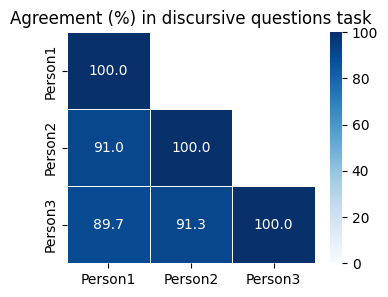

In [22]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Converta para np.array para facilitar
avaliadores = [
    np.array(avaliador1, dtype=int),
    np.array(avaliador2, dtype=int),
    np.array(avaliador3, dtype=int)
]

n = len(avaliadores)

# Matriz para guardar a % de concordância
matriz_concordancia = np.zeros((n, n))

# Calcula a % de concordância par a par
for i in range(n):
    for j in range(n):
        iguais = avaliadores[i] == avaliadores[j]
        matriz_concordancia[i, j] = np.mean(iguais) * 100  # porcentagem de acerto

# Converte para DataFrame
df_concordancia = pd.DataFrame(matriz_concordancia, 
                               index=[f"Person{i+1}" for i in range(n)], 
                               columns=[f"Person{i+1}" for i in range(n)])

# Cria máscara para a parte superior da matriz
mask = np.triu(np.ones_like(df_concordancia, dtype=bool), k=1)

# Plot
plt.figure(figsize=(4, 3))
sns.heatmap(df_concordancia, annot=True, fmt=".1f", cmap="Blues", 
            vmin=0, vmax=100, mask=mask, cbar=True, square=False, linewidths=0.5)
plt.title('Agreement (%) in discursive questions task')
plt.show()


golden standard: majority vote 

In [23]:
assert len(avaliador1) == len(avaliador2) == len(avaliador3)

In [24]:
golden_labels = []
for i in range(len(avaliador1)):
    label = 1 if avaliador1[i]+avaliador2[i]+avaliador3[i] >= 2 else 0
    golden_labels.append(label)

In [25]:
golden_labels[0:20]

[1, 0, 1, 0, 1, 0, 1, 0, 1, 0, 0, 1, 0, 0, 0, 1, 0, 1, 0, 0]

In [26]:
assert len(golden_labels) == len(avaliador1)

In [27]:
# Remove o campo 'humano' dos três DataFrames
df_h0 = df_human_answers_h0.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_1'})
df_h1 = df_human_answers_h1.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_2'})
df_h2 = df_human_answers_h2.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_3'})

# Faz o merge
df_human_human_answers2 = df_h0.merge(df_h1, on=['exame', 'area', 'numero', 'letra', 'parte'], how='inner') \
                 .merge(df_h2, on=['exame', 'area', 'numero', 'letra', 'parte'], how='inner')
for ix, row in df_human_human_answers2.iterrows():
    df_human_human_answers2.at[ix, 'golden_label'] = '1' if int(row['avaliacao_1']) + int(row['avaliacao_2']) + int(row['avaliacao_3']) >= 2 else '0'


In [30]:
from sklearn.metrics import accuracy_score
print(accuracy_score(df_human_human_answers2.golden_label, df_human_human_answers2.avaliacao_3))

0.9498680738786279


In [31]:
assert [str(x) for x in golden_labels] == list(df_human_human_answers2.golden_label)

In [32]:
# Calcular acurácia individual dos avaliadores
acc1 = accuracy_score(df_human_human_answers2['golden_label'], df_human_human_answers2['avaliacao_1'])
acc2 = accuracy_score(df_human_human_answers2['golden_label'], df_human_human_answers2['avaliacao_2'])
acc3 = accuracy_score(df_human_human_answers2['golden_label'], df_human_human_answers2['avaliacao_3'])

print(f"Accuracy with Golden Label Person1 {round(acc1,3)} Person2 {round(acc2,3)} Person3 {round(acc3,3)} ")

Accuracy with Golden Label Person1 0.947 Person2 0.963 Person3 0.95 


In [33]:
def corrigir_avaliacao(formated_criteria, evaluation):
    #print('Entrou no corrigir')
    
    # Remove entradas sem número ou parte
    evaluation = [
        item for item in evaluation 
        if item.get('letra') is not None and item.get('parte') is not None
    ]
    
    # Coleta os pares (numero, parte) que já foram avaliados
    avaliados = {(item['letra'], item['parte']) for item in evaluation}
    #print('Pegou avaliados')

    #faltantes = 0

    for criterio in formated_criteria:
        chave = (criterio['letra'], criterio['parte'])

        if chave not in avaliados:
            novo_item = criterio.copy()
            novo_item['acerto'] = -1
            novo_item['raciocinio'] = 'Critério não avaliado pelo modelo ou falha em representar a estrutura.'
            evaluation.append(novo_item)
            #faltantes += 1
            print(f"[ADICIONADO] Critério {chave} foi incluído com acerto = -1")

    return evaluation

comparacao modelo com humanos

In [34]:
#mera depuração de erro, ignorar
erros = 0
erros_list = []
for ix, row in df_discursive.query("judge_model == 'sabia-3' ").iterrows():
    #print('ok')
    evaluations1 = row.evaluation
    if 'resultado' in evaluations1:
        evaluations_final = evaluations1['resultado']
    else:
        evaluations_final = row.evaluation

    for evalu in evaluations_final:
        if 'parte' not in evalu:
            erros_list.append(evaluations_final)
            erros = erros + 1
            print('Não encontrou parte...')
            print(f'caso {evalu}')
            print(f'contexto {evaluations_final}')
            print('--------')
print(f'erros {erros}')

Não encontrou parte...
caso {'cache_beaker': 71}
contexto [{'letra': 'A', 'parte': 'I', 'acerto': 1, 'raciocinio': 'O candidato mencionou corretamente a obrigatoriedade da matriz de alocação de riscos em contratos de grande vulto conforme a Lei no 14.133/2021.', 'pontos': 0.55}, {'letra': 'A', 'parte': 'II', 'acerto': 1, 'raciocinio': 'O candidato citou adequadamente o Art. 22, § 3o, da Lei no 14.133/2021, referente à inclusão da matriz de alocação de riscos no edital.', 'pontos': 0.1}, {'letra': 'B', 'parte': 'I', 'acerto': 1, 'raciocinio': 'O candidato afirmou corretamente que é possível exigir a implementação de um programa de integridade em contratos de grande vulto, conforme a Lei no 14.133/2021.', 'pontos': 0.5}, {'letra': 'B', 'parte': 'II', 'acerto': 1, 'raciocinio': 'O candidato mencionou corretamente o Art. 25, § 4o, da Lei no 14.133/2021, que prevê a obrigatoriedade de implementação de programa de integridade.', 'pontos': 0.1}, {'cache_beaker': 71}]
--------
Não encontrou pa

In [35]:
exams = df_discursive['exam'].unique()
areas = df_discursive['area'].unique()
models = df_discursive['judge_model'].unique()

df_model_scores = pd.DataFrame(columns=['model','scores'])
df_model_answers_discursive = pd.DataFrame(columns=['model','experiment','judge','exam', 'area', 'number', 'letra', 'parte','evaluation', 'score'])

last_case =''
last_context = []
try:
    for model in models:
        
        print(f'Evaluation {model}')
        for experiment in range(0,10):
             for judge in range(0,5):
                exam_score = 0
                for exam in exams:
                    for area in areas:
                        for number in range(1,5):
                            model_scores  = []
                            for ix, row in df_discursive.query('exam == @exam & area == @area & judge_model == @model & number == @number & judge_number == @judge & experiment == @experiment').iterrows():
                                evaluation = row.evaluation
                                if 'resultado' in evaluation:
                                    evaluation = evaluation['resultado']
                                #print(evaluation)
                                evaluation = corrigir_avaliacao(row.formated_criteria, evaluation)
                                last_context = evaluation
                                # treatment to points
                                if 'pontos' not in evaluation[0]: #so the we need to take the scoring points in reference 
                                    for e in evaluation:
                                        last_case = e
                                        if 'parte' not in e or 'acerto' not in e:
                                            print('Sem parte')
                                            #print(z)
                                            continue
                                        e_letra = e['letra']
                                        e_parte = e['parte']
                                        #now we need to find this question in reference
                                        for c in row.formated_criteria:
                                            c_letra = c['letra']
                                            c_parte = c['parte']
                                            if e_letra == c_letra and e_parte == c_parte:
                                                #ok, we found the match, so we need to extract the points
                                                e['pontos'] = c['pontos']
                                for z in evaluation:
                                    #print(z)
                                    if 'parte' not in z or 'acerto' not in z:
                                        print('Sem parte ou acerto')
                                        print(z)
                                        continue

                                    z_letra = z['letra']
                                    z_parte = z['parte']
                                    z_acerto = z['acerto']
                                    z_pontos = z['pontos']
                                    for c in row.formated_criteria:
                                        c_letra = c['letra']
                                        c_parte = c['parte']
                                        if z_letra == c_letra and z_parte == c_parte:
                                            z['pontos'] = c['pontos']


                                    if 'pontos'  in z:
                                        z_pontos = z['pontos']
                                    else:
                                        z_pontos = 0
                                    #print(z_letra, z_parte, z_acerto, z_pontos)
                                    df_model_answers_discursive = pd.concat([df_model_answers_discursive, pd.DataFrame({'model':[model],'experiment':[experiment],'judge':[judge],'exam':[exam],'area':[area],'number':[number],'letra':[z_letra],'parte':[z_parte],'evaluation':[z_acerto],'score':[z_pontos]})], ignore_index=True)
                                    
except Exception as e:
    print('ERRO ',e)
    

Evaluation gpt4o-mini


/tmp/ipykernel_37476/3470429198.py:68: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_model_answers_discursive = pd.concat([df_model_answers_discursive, pd.DataFrame({'model':[model],'experiment':[experiment],'judge':[judge],'exam':[exam],'area':[area],'number':[number],'letra':[z_letra],'parte':[z_parte],'evaluation':[z_acerto],'score':[z_pontos]})], ignore_index=True)


Evaluation gpt4o
Evaluation gpt41-mini
Evaluation gpt41
Evaluation sabiazinho-3
[ADICIONADO] Critério ('B', 'III') foi incluído com acerto = -1


/tmp/ipykernel_37476/3470429198.py:68: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  df_model_answers_discursive = pd.concat([df_model_answers_discursive, pd.DataFrame({'model':[model],'experiment':[experiment],'judge':[judge],'exam':[exam],'area':[area],'number':[number],'letra':[z_letra],'parte':[z_parte],'evaluation':[z_acerto],'score':[z_pontos]})], ignore_index=True)


Evaluation sabia-3
Sem parte ou acerto
{'letra': 'A2', 'parte': 'I', 'criterio_extra': 'cache_beaker', 'valor_cache_beaker': 116}
Sem parte ou acerto
{'letra': 'A2', 'parte': 'II', 'criterio_extra': 'cache_beaker', 'valor_cache_beaker': 116}
Sem parte ou acerto
{'letra': 'B', 'parte': 'I', 'criterio_extra': 'cache_beaker', 'valor_cache_beaker': 116}
Sem parte ou acerto
{'letra': 'B', 'parte': 'II', 'criterio_extra': 'cache_beaker', 'valor_cache_beaker': 116}
Evaluation gpto3-mini


In [36]:
partes_validas = ['I', 'II', 'III', 'IV', 'V', 'VI','VII','VIII','IX','X']
evaluations_validas = [0,1,-1]
df_model_answers2 = df_model_answers_discursive[df_model_answers_discursive['parte'].isin(partes_validas)]
df_model_answers2 = df_model_answers2[df_model_answers2['evaluation'].isin(evaluations_validas)]
df_model_answers2.drop_duplicates(['model','experiment','judge','exam','area','number','letra','parte','evaluation'])
df_model_answers2['model'].value_counts()

model
sabiazinho-3    18963
gpt4o           18950
gpt4o-mini      18950
gpt41-mini      18950
gpt41           18950
sabia-3         18950
gpto3-mini      18950
Name: count, dtype: int64

In [101]:
df_model_answers2.to_pickle('respostas_discursivas.pkl')

In [37]:
df_model_answers2_discursive = pd.read_pickle('respostas_discursivas.pkl')

In [38]:
def unifica_dfs_discursive(df,df2):
    # Primeiro, renomeie as colunas do df1 para que coincidam com as do df2
    df1_renomeado = df.rename(columns={
        'exam': 'exame',
        'number': 'numero',
        'score': 'potential_score',
        'experiment':'experimento'
    })
    #print('A')
    # Agora faça o merge com base nas colunas relevantes
    df_merged = df2.merge(
        df1_renomeado[['model','experimento','judge','exame', 'area', 'numero', 'parte', 'evaluation','potential_score']],
        on=['exame', 'area', 'numero', 'parte'],
        #how='left'
        how='inner'
    )
    #print('B')

    # Converta explicitamente os tipos das colunas usadas no merge para garantir correspondência
    df['exam'] = df['exam'].astype(str)
    df['area'] = df['area'].astype(str)
    df['number'] = df['number'].astype(str)
    df['parte'] = df['parte'].astype(str)
    df['letra'] = df['letra'].astype(str)
    df['experiment'] = df['experiment'].astype(str)
    df['judge'] = df['judge'].astype(str)

    df2['exame'] = df2['exame'].astype(str)
    df2['area'] = df2['area'].astype(str)
    df2['numero'] = df2['numero'].astype(str)
    df2['parte'] = df2['parte'].astype(str)
    df2['letra'] = df2['letra'].astype(str)

    #print('C')
    # Renomeie para facilitar o merge
    df1_renomeado = df.rename(columns={'exam': 'exame', 'number': 'numero','score': 'potential_score','experiment':'experimento'})

    #print(df1_renomeado.columns)
    # Faça o merge
    df_merged = df2.merge(
        df1_renomeado[['model','experimento','judge','exame', 'area', 'numero','letra', 'parte', 'evaluation','potential_score']],
        on=['exame', 'area', 'numero', 'parte','letra'],
        how='inner'
    )
    #print('D')
    # Renomeie o campo final
    df_merged = df_merged.rename(columns={'evaluation': 'avaliacao_modelo'})
    df_merged['golden_label'] = df_merged['golden_label'].astype(int)
    df_merged['avaliacao_modelo'] = df_merged['avaliacao_modelo'].astype(int)
    df_merged['score_by_golden_label'] =  df_merged['golden_label'] * df_merged['potential_score'] 
    df_merged['score_by_model'] =  df_merged['avaliacao_modelo'] * df_merged['potential_score'] 
    return df_merged

In [39]:
import warnings
warnings.filterwarnings('ignore')

In [40]:
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from scipy.stats import pearsonr, spearmanr
experiments = list(range(10))
judges = range(5)
exams = range(39,42)

models = list(df_discursive['judge_model'].unique())
#models.remove('sabiazinho-3')
df_all_scores_discursive = pd.DataFrame(columns = ['exame', 'area', 'numero', 'letra', 'parte', 'avaliacao_1',
       'avaliacao_2', 'avaliacao_3', 'golden_label', 'model',
       'avaliacao_modelo', 'potential_score', 'score_by_golden_label','score_by_model'])
areas = list(df_discursive['area'].unique())
df_exp2 = pd.DataFrame(columns = ['model','exam','experiment','judge','cohen_kappa','accuracy','score_spearman_corr','score_spearman_p','score_pearson_corr','score_pearson_p','score_mae'])
df_exp3 = pd.DataFrame(columns = ['model','exam','experiment','judge','area','cohen_kappa','accuracy'])
for model in models:
    print(model)
    for exam in exams:
        for experiment in experiments:
            for judge in judges:
                #print(model, exam, experiment, judge)
                df = df_model_answers2_discursive.query('model == @model and judge == @judge and exam == @exam and experiment == @experiment')
                exam_s = str(exam)
                df2 = df_human_human_answers2.query('exame == @exam_s ')
                #df_ordered = df.sort_values(by=['exam','area','number','letra','parte'])
                #df2_ordered = df2.sort_values(by=['exame','area','numero','letra','parte'])
                #df_ordered['evaluation'] = df_ordered['evaluation'].astype(str)
                df_merged = unifica_dfs_discursive(df,df2)
                df_all_scores_discursive = pd.concat([df_all_scores_discursive, df_merged],ignore_index=True)
                accuracy= accuracy_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                cohen_kappa = cohen_kappa_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                pearson_corr, pearson_p = pearsonr(df_merged['score_by_golden_label'], df_merged['score_by_model'])
                spearman_corr, spearman_p = spearmanr(df_merged['score_by_golden_label'], df_merged['score_by_model'])
                score_mae = mean_absolute_error(df_merged['score_by_golden_label'], df_merged['score_by_model'])
                df_exp2 = pd.concat([df_exp2,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge], 'cohen_kappa':[cohen_kappa],'accuracy':[accuracy],
                'score_spearman_corr': [spearman_corr],'score_spearman_p': [spearman_p],
                'score_pearson_corr': [pearson_corr], 'score_pearson_p': [pearson_p],
                'score_mae': [score_mae]}) ],ignore_index=True)
                #agora coloca area por area
                for area in areas:
                    df_discursive_area = df_merged.query("area == @area")
                    accuracy_area= accuracy_score(df_discursive_area.golden_label, df_discursive_area.avaliacao_modelo)
                    cohen_kappa_area = cohen_kappa_score( df_discursive_area.golden_label,  df_discursive_area.avaliacao_modelo)
                    pearson_corr, pearson_p = pearsonr(df_discursive_area['score_by_golden_label'], df_discursive_area['score_by_model'])
                    spearman_corr, spearman_p = spearmanr(df_discursive_area['score_by_golden_label'], df_discursive_area['score_by_model'])
                    score_mae = mean_absolute_error(df_discursive_area['score_by_golden_label'], df_discursive_area['score_by_model'])
                    df_exp3 = pd.concat([df_exp3,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge],'area':[area], 'cohen_kappa':[cohen_kappa_area],'accuracy':[accuracy_area],
                    'score_spearman_corr': [spearman_corr],'score_spearman_p': [spearman_p],
                    'score_pearson_corr': [pearson_corr], 'score_pearson_p': [pearson_p],
                    'score_mae': [score_mae]}) ],ignore_index=True)



gpt4o-mini
gpt4o
gpt41-mini
gpt41
sabiazinho-3
sabia-3
gpto3-mini


In [41]:
df_discursive_scores = pd.DataFrame(columns=['model','exame','area','experimento','judge','score_by_golden_label', 'score_by_model','normalized_score_by_golden_label','normalized_score_by_model'])
all = df_all_scores_discursive.groupby(['model','exame','area','experimento','judge'])[['score_by_golden_label', 'score_by_model']].sum()
for index, row in all.iterrows():
    model, exame, area, experimento, judge = index  # descompacta os índices do grupo
    score_golden = row['score_by_golden_label']
    score_model = row['score_by_model']
    normalized_score_golden = score_golden *20
    normalized_score_model = score_golden *20
    df_discursive_scores = pd.concat([df_discursive_scores, pd.DataFrame([{
    'model': model,
    'exame': exame,
    'area': area,
    'experimento': experimento,
    'judge': judge,
    'score_by_golden_label': score_golden,
    'score_by_model': score_model,
    'normalized_score_by_golden_label': score_golden *20,  
    'normalized_score_by_model': score_model *20
}])], ignore_index=True)


In [42]:
from sklearn.metrics import mean_absolute_error
from scipy.stats import pearsonr, spearmanr
import pandas as pd

# DataFrame de saída
df_metricas = pd.DataFrame(columns=[
    'model', 'area', 'experimento',
    'mae_normalized',
    'pearson_corr', 'pearson_pvalue',
    'spearman_corr', 'spearman_pvalue'
])

# Agrupamento por model, area, experimento
agrupado = df_discursive_scores.groupby(['model', 'area', 'experimento'])

for (model, area, experimento), grupo in agrupado:
    # Extrai os vetores normalizados
    golden_scores = grupo['normalized_score_by_golden_label'].astype(float)
    model_scores = grupo['normalized_score_by_model'].astype(float)

    # Calcula as métricas
    mae = mean_absolute_error(golden_scores, model_scores)
    pearson_corr, pearson_p = pearsonr(golden_scores, model_scores)
    spearman_corr, spearman_p = spearmanr(golden_scores, model_scores)

    # Adiciona à tabela de resultados
    df_metricas = pd.concat([df_metricas, pd.DataFrame([{
        'model': model,
        'area': area,
        'experimento': experimento,
        'mae_normalized': mae,
        'pearson_corr': pearson_corr,
        'pearson_pvalue': pearson_p,
        'spearman_corr': spearman_corr,
        'spearman_pvalue': spearman_p
    }])], ignore_index=True)

In [43]:
df_discursive_scores

,model,exame,area,experimento,judge,score_by_golden_label,score_by_model,normalized_score_by_golden_label,normalized_score_by_model
0,gpt41,39,administrativo,0,0,3.5,3.50,70.0,70.0
1,gpt41,39,administrativo,0,1,3.5,4.00,70.0,80.0
2,gpt41,39,administrativo,0,2,3.5,4.00,70.0,80.0
3,gpt41,39,administrativo,0,3,3.5,4.00,70.0,80.0
4,gpt41,39,administrativo,0,4,3.5,4.00,70.0,80.0
...,...,...,...,...,...,...,...,...,...
7345,sabiazinho-3,41,tributário,9,0,2.7,1.15,54.0,23.0
7346,sabiazinho-3,41,tributário,9,1,2.7,1.15,54.0,23.0
7347,sabiazinho-3,41,tributário,9,2,2.7,1.05,54.0,21.0
7348,sabiazinho-3,41,tributário,9,3,2.7,1.05,54.0,21.0


In [44]:
df_metricas

,model,area,experimento,mae_normalized,pearson_corr,pearson_pvalue,spearman_corr,spearman_pvalue
0,gpt41,administrativo,0,4.066667,0.977616,3.505061e-10,0.882523,0.000013
1,gpt41,administrativo,1,3.666667,0.936173,2.876891e-07,0.870877,0.000024
2,gpt41,administrativo,2,6.933333,0.932721,4.017540e-07,0.552006,0.032882
3,gpt41,administrativo,3,5.466667,0.979091,2.257939e-10,0.773389,0.000719
4,gpt41,administrativo,4,6.066667,0.955464,2.906759e-08,0.675454,0.005718
...,...,...,...,...,...,...,...,...
485,sabiazinho-3,tributário,5,15.533333,-0.908584,2.776978e-06,-0.844350,0.000075
486,sabiazinho-3,tributário,6,15.800000,-0.915049,1.751712e-06,-0.840366,0.000088
487,sabiazinho-3,tributário,7,13.733333,-0.888304,9.712100e-06,-0.840366,0.000088
488,sabiazinho-3,tributário,8,15.666667,-0.919274,1.270560e-06,-0.845154,0.000073


agora vamos pegar as respostas da primeira fase

In [45]:
df_objective = pd.read_pickle('respostas_objetivas_com_area.pkl')

In [46]:
df_objective['area'].unique()

array(['ética', 'filosofia', 'constitucional', 'direitos humanos',
       'eleitoral', 'internacional', 'financeiro', 'tributario',
       'administrativo', 'ambiental', 'civil', 'ECA', 'consumidor',
       'empresarial', 'processo civil', 'penal', 'processo penal',
       'previdenciario', 'trabalho', 'processo do trabalho'], dtype=object)

In [47]:
dict_areas =  {'civil': ['civil','processo sivil'],
               'penal': ['penal','processo penal'],
               'trabalhista' : ['trabalho','processo do trabalho'],
               'tributário': ['tributario'],
               'administrativo': ['administrativo'],
               'constitucional': ['constitucional'],
               'empresarial': ['empresarial']
               }

In [48]:
def first_phase_score_area(df,area,model, exam):
    areas = dict_areas[area]

    df_area = df.query("area in @areas and model == @model and exam == @exam  ")
    qtd = len(df_area)
    acertos = len(df_area.query("model_answer == answer"))
    score = acertos/qtd *100
    return round(score,2)
    

In [49]:
def target_score_area(df,area, model, exam):
    exam= str(exam)
    df_area = df.query("area == @area  and model == @model and exame == @exam ")
    score = df_area['normalized_score_by_golden_label'].mean()
    return round(score,2)

In [50]:
def second_phase_score_area(df,area, model, exam):

    exam= str(exam)
    df_area = df.query("area == @area and model == @model and  exame == @exam ")
    score = df_area['normalized_score_by_model'].mean()
    return round(score,2)

In [51]:
dict_models = {'gpt4o':'gpt_4o', 'gpt4o-mini':  'gpt_4o_mini', 'gpto3-mini':'gpt_o3_mini',  'sabiazinho-3' :'sabiazinho3','sabia-3' : 'sabia3', 'gpt41': 'gpt_41', 'gpt41-mini':   'gpt_41_mini'    }

In [52]:
df_proxy_experiment_discursive = pd.DataFrame(columns=['model','exam','area','first_phase','discursive','target'])
exames = [e for e in  list(df_objective['exam'].unique()) if e in list(df_discursive['exam'].unique())]
print(exames)
for area in list(df_discursive['area'].unique()):
    for model in list(df_discursive['judge_model'].unique()):
        for exame in exames:
            #print(model, area)
            first_phase = first_phase_score_area(df_objective,area,dict_models[model], exame)
            second_phase = second_phase_score_area(df_discursive_scores ,area,model, exame)
            target = target_score_area(df_discursive_scores ,area,model, exame)
            df_proxy_experiment_discursive = pd.concat([df_proxy_experiment_discursive, pd.DataFrame({'model': [model],'exam': [exame],'area':[area], 'first_phase': [first_phase], 'discursive': [second_phase], 'target': [target]})],ignore_index=True)
df_proxy_experiment_discursive.sample(3)

[41, 40]


,model,exam,area,first_phase,discursive,target
20,gpt41,41,civil,100.0,46.68,48.0
18,gpt41-mini,41,civil,100.0,45.94,48.0
3,gpt4o,40,administrativo,100.0,40.84,43.0


In [ ]:

# DataFrame final com area incluída
df_proxy_experiment_discursive_scores = pd.DataFrame(columns=[
    'model', 'area',
    'mean_first_phase', 'mean_discursive', 'mean_target',
    'mae_first_phase', 'mae_discursive',
    'rmse_first_phase', 'rmse_discursive',

])


# Iteração por modelo e área
for (model, area), group in df_proxy_experiment_discursive.groupby(['model', 'area']):
    x1 = group['first_phase'].values.reshape(-1, 1)
    x2 = group['discursive'].values.reshape(-1, 1)
    y = group['target'].values


    df_proxy_experiment_discursive_scores = pd.concat([df_proxy_experiment_discursive_scores, pd.DataFrame({
        'model': [model],
        'area': [area],
        'mean_first_phase': [round(np.mean(group['first_phase']),2)],
        'mean_discursive': [round(np.mean(group['discursive']),2)],
        'mean_target': [round(np.mean(group['target']),2)],
        'mae_first_phase': [round(mean_absolute_error(y, group['first_phase']),2)],
        'mae_discursive': [round(mean_absolute_error(y, group['discursive']),2)],
        'rmse_first_phase': [round(np.sqrt(mean_squared_error(y, group['first_phase'])),2)],
        'rmse_discursive': [round(np.sqrt(mean_squared_error(y, group['discursive'])),2)],
    })], ignore_index=True)
    #print(round(np.sqrt(mean_squared_error(y, group['first_phase'])),2))


In [56]:
df_proxy_experiment_discursive_scores.groupby(['model'])[['mean_first_phase','mean_discursive','mean_target','mae_first_phase','mae_discursive','rmse_first_phase','rmse_discursive']].mean()

,mean_first_phase,mean_discursive,mean_target,mae_first_phase,mae_discursive,rmse_first_phase,rmse_discursive
model,,,,,,,
gpt41,70.715714,47.317143,44.571429,27.904286,7.237143,31.424286,7.734286
gpt41-mini,79.761429,47.391429,44.571429,35.190000,7.340000,36.664286,7.805714
gpt4o,85.475714,43.681429,44.571429,40.951429,5.335714,42.455714,6.088571
gpt4o-mini,64.642857,57.350000,44.571429,21.500000,13.512857,23.002857,13.948571
gpto3-mini,66.072857,31.631429,44.571429,22.975714,12.940000,24.798571,14.881429
sabia-3,76.428571,58.172857,44.571429,31.857143,13.907143,32.948571,15.520000
sabiazinho-3,69.287143,44.355714,44.581429,26.134286,11.082857,28.540000,12.468571


In [57]:
df_proxy_experiment_discursive_scores.query('model == "gpt4o"')

,model,area,mean_first_phase,mean_discursive,mean_target,mae_first_phase,mae_discursive,rmse_first_phase,rmse_discursive
14,gpt4o,administrativo,90.00,40.92,42.0,48.00,1.08,48.84,1.53
15,gpt4o,civil,75.00,54.18,57.5,17.83,3.32,24.98,3.70
16,gpt4o,constitucional,75.00,41.25,45.5,29.50,4.25,29.52,5.05
17,gpt4o,empresarial,100.00,47.54,45.5,54.50,8.60,56.40,8.84
18,gpt4o,penal,83.33,40.38,36.0,47.33,5.38,47.59,6.94
19,gpt4o,trabalhista,85.00,43.32,42.5,42.50,9.18,42.85,9.22
20,gpt4o,tributário,90.00,38.18,43.0,47.00,5.54,47.01,7.34


In [ ]:


# DataFrame de saída
df_proxy_experiment_discursive_scores_univariate_regression = pd.DataFrame(columns=[
    'model',
    'r2_first_phase', 'r2_discursive', 'coef_first_phase', 'coef_discursive', 'mae_first_phase',  'mae_discursive',  'rmse_first_phase',
     'rmse_discursive'
])

# Itera por modelo
for model, group in df_proxy_experiment_discursive_scores.groupby('model'):
    x1 = group['mean_first_phase'].values.reshape(-1, 1)
    x2 = group['mean_discursive'].values.reshape(-1, 1)
    y = group['mean_target'].values

    # Regressão com primeira fase
    reg1 = LinearRegression().fit(x1, y)
    y_pred1 = reg1.predict(x1)

    # Regressão com segunda fase
    reg2 = LinearRegression().fit(x2, y)
    y_pred2 = reg2.predict(x2)

    # RMSE manual (sem `squared=False`)
    rmse1 = np.sqrt(mean_squared_error(y, y_pred1))
    rmse2 = np.sqrt(mean_squared_error(y, y_pred2))

    # Adiciona ao DataFrame
    df_proxy_experiment_discursive_scores_univariate_regression = pd.concat([df_proxy_experiment_discursive_scores_univariate_regression, pd.DataFrame({
        'model': [model],
        'r2_first_phase': [r2_score(y, y_pred1)],
        'r2_discursive': [r2_score(y, y_pred2)],
        'coef_first_phase': [reg1.coef_[0]],
        'coef_discursive': [reg2.coef_[0]],
        'mae_first_phase': [mean_absolute_error(y, y_pred1)],
        'mae_discursive': [mean_absolute_error(y, y_pred2)],
        'rmse_first_phase': [rmse1],
        'rmse_discursive': [rmse2],
    })], ignore_index=True)


In [59]:
df_proxy_experiment_discursive_scores_univariate_regression

,model,r2_first_phase,r2_discursive,coef_first_phase,coef_discursive,mae_first_phase,mae_discursive,rmse_first_phase,rmse_discursive
0,gpt41,0.152035,0.363452,0.175624,0.655237,4.253352,4.401594,5.565671,4.822188
1,gpt41-mini,0.314196,0.380670,0.314596,0.715470,3.951647,4.338981,5.005282,4.756522
2,gpt4o,0.141019,0.718681,-0.275182,1.010601,4.277496,2.832021,5.601705,3.205735
3,gpt4o-mini,0.204223,0.216387,0.288454,0.453793,4.138255,3.987787,5.391682,5.350314
4,gpto3-mini,0.006738,0.631612,-0.049687,0.924754,4.308979,2.716048,6.023659,3.668438
5,sabia-3,0.076845,0.213196,0.142003,0.305816,4.277969,4.300344,5.807185,5.361196
6,sabiazinho-3,0.015902,0.272962,0.117000,0.301279,4.302175,4.296104,5.918862,5.087423


In [60]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# DataFrame de saída
df_proxy_experiment_discursive_scores_bivariate_regression = pd.DataFrame(columns=[
    'model',
    'r2_combined', 'mae_combined', 'rmse_combined',
    'coef_first_phase', 'coef_discursive'
])

# Itera por modelo
for model, group in df_proxy_experiment_discursive_scores.groupby('model'):
    # Features combinadas: primeira e segunda fase
    X = group[['mean_first_phase', 'mean_discursive']].values
    y = group['mean_target'].values

    # Regressão múltipla
    reg = LinearRegression().fit(X, y)
    y_pred = reg.predict(X)

    # RMSE
    rmse = np.sqrt(mean_squared_error(y, y_pred))

    # Adiciona ao DataFrame
    df_proxy_experiment_discursive_scores_bivariate_regression = pd.concat([df_proxy_experiment_discursive_scores_bivariate_regression, pd.DataFrame({
        'model': [model],
        'r2_combined': [r2_score(y, y_pred)],
        'mae_combined': [mean_absolute_error(y, y_pred)],
        'rmse_combined': [rmse],
        'coef_first_phase': [reg.coef_[0]],
        'coef_discursive': [reg.coef_[1]],
    })], ignore_index=True)


In [61]:
df_proxy_experiment_discursive_scores_bivariate_regression 

,model,r2_combined,mae_combined,rmse_combined,coef_first_phase,coef_discursive
0,gpt41,0.363722,4.419555,4.821163,0.009495,0.640907
1,gpt41-mini,0.437585,4.304493,4.532701,0.167185,0.508615
2,gpt4o,0.762818,2.294791,2.943537,-0.157130,0.959436
3,gpt4o-mini,0.348908,3.991765,4.876964,0.237437,0.379173
4,gpto3-mini,0.631688,2.709824,3.668061,0.005299,0.925917
5,sabia-3,0.309515,4.538754,5.022334,0.159373,0.320266
6,sabiazinho-3,0.275823,4.373567,5.077400,0.050127,0.296918


o mae será calculado por área, modelo e experimento. assim, juízes e exames  formam os 15 valores que comporão 1 MAE; teremos 10 MAES para ser possível fazer o boxplot

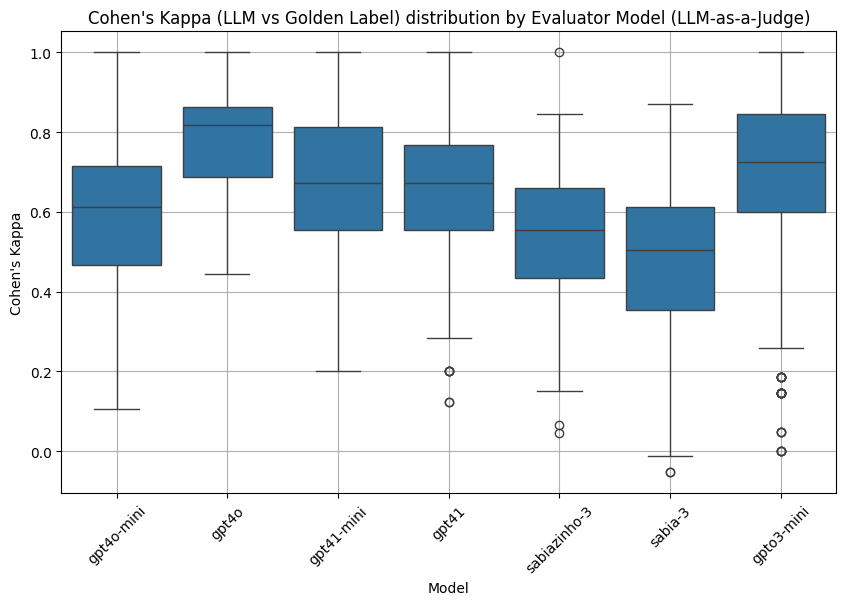

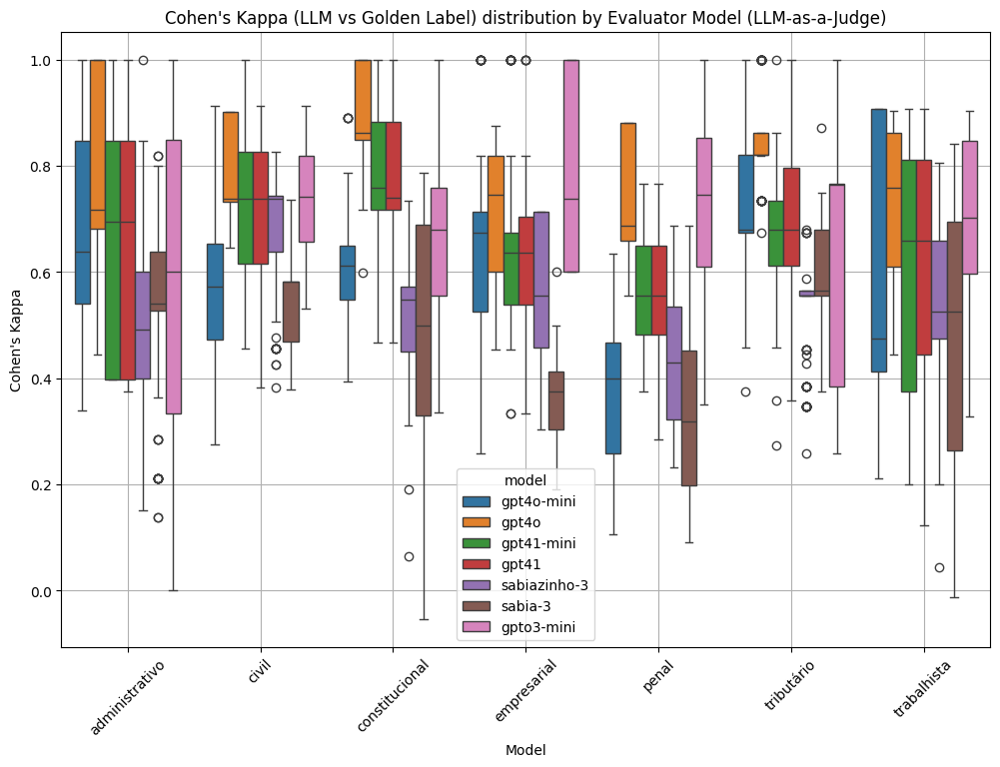

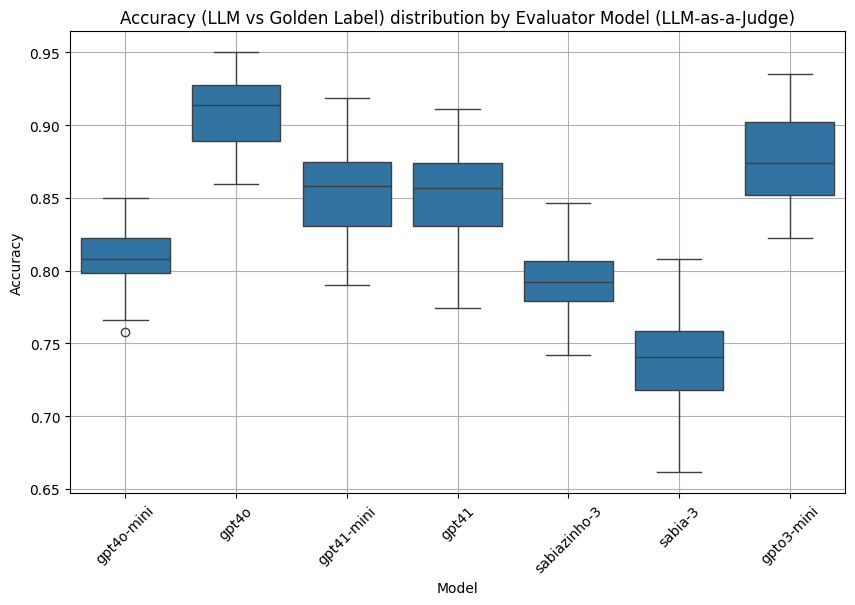

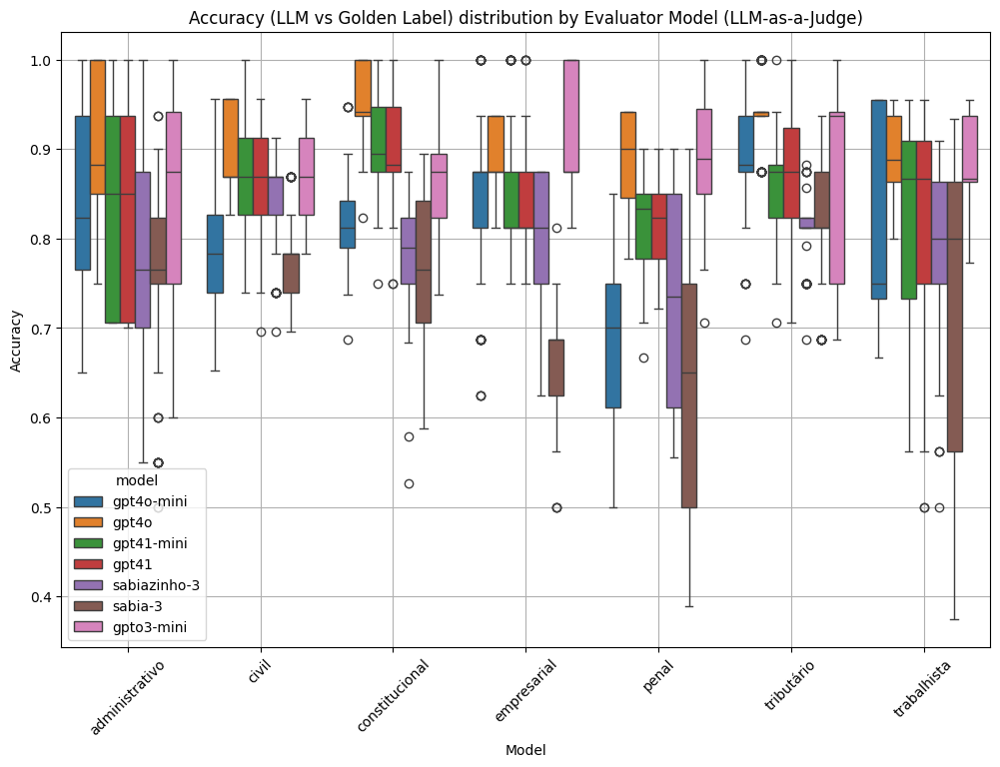

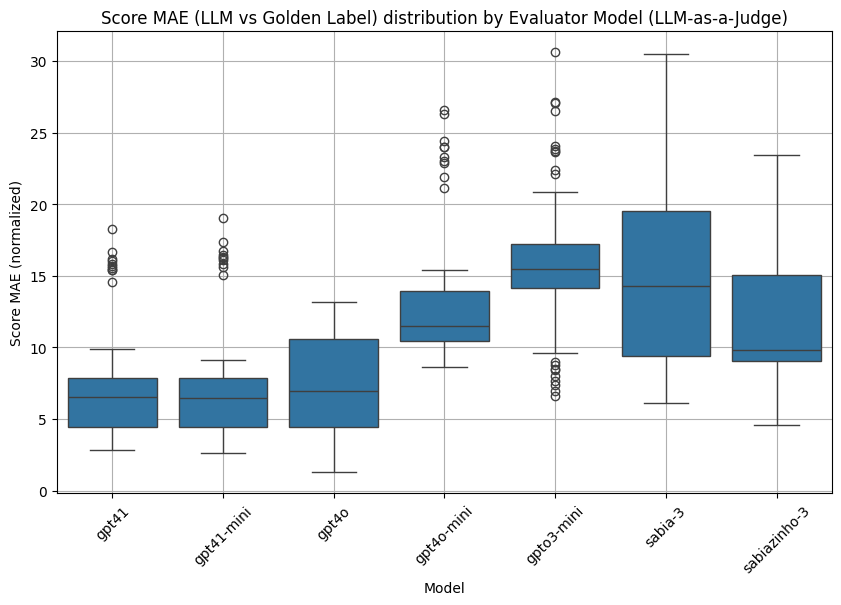

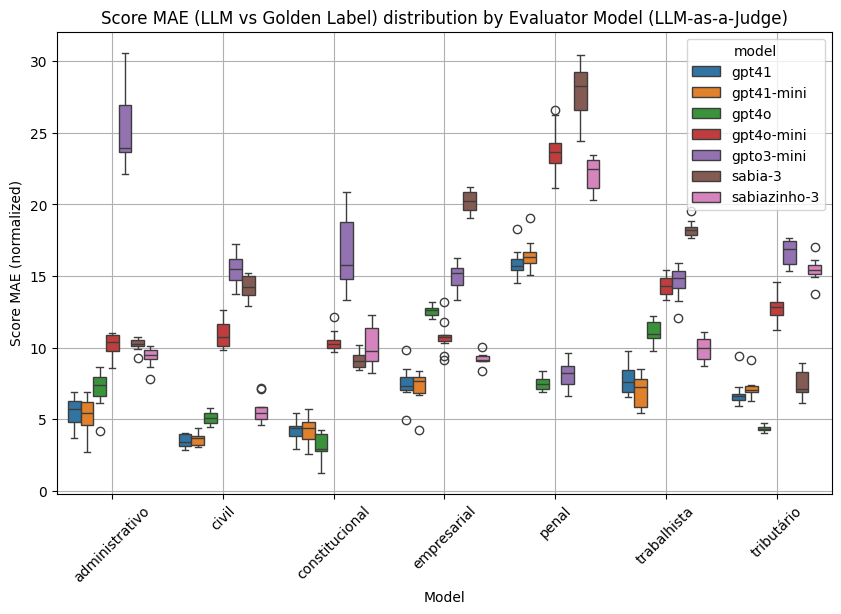

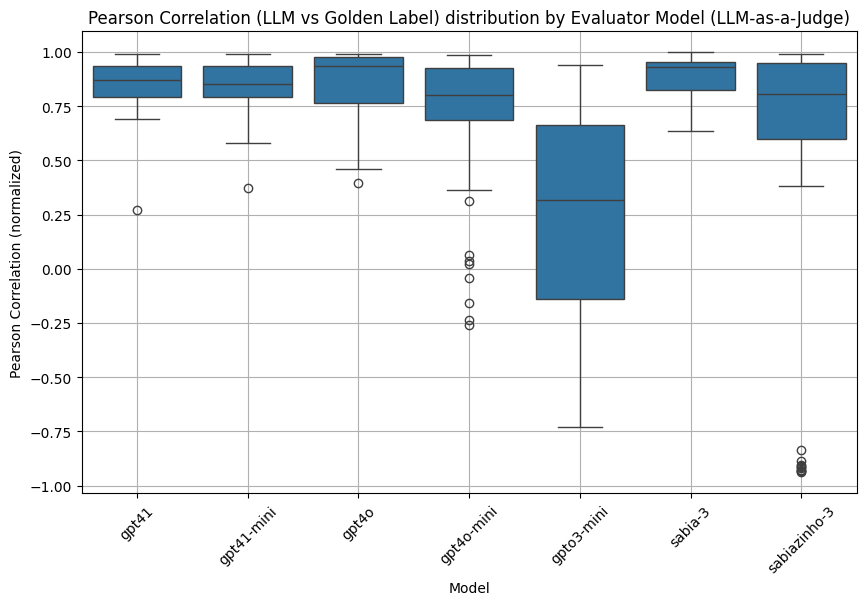

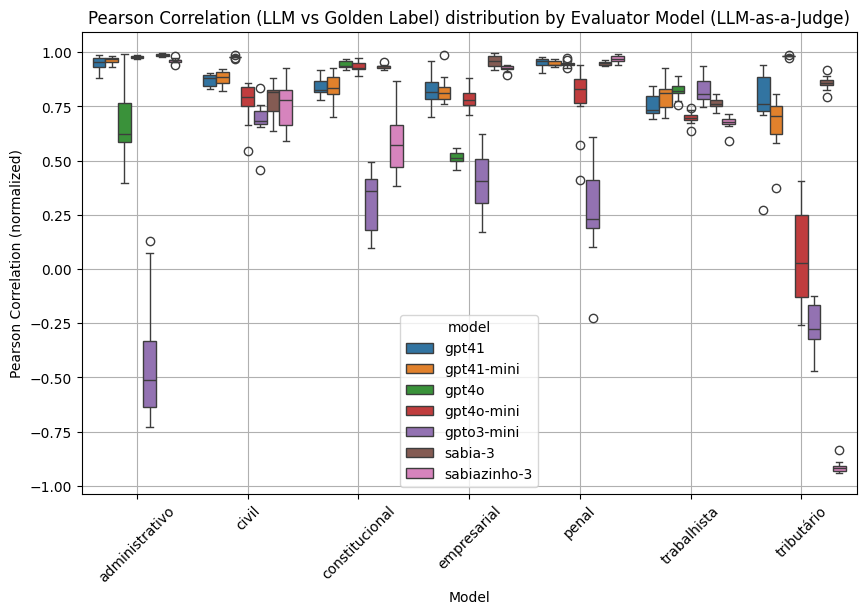

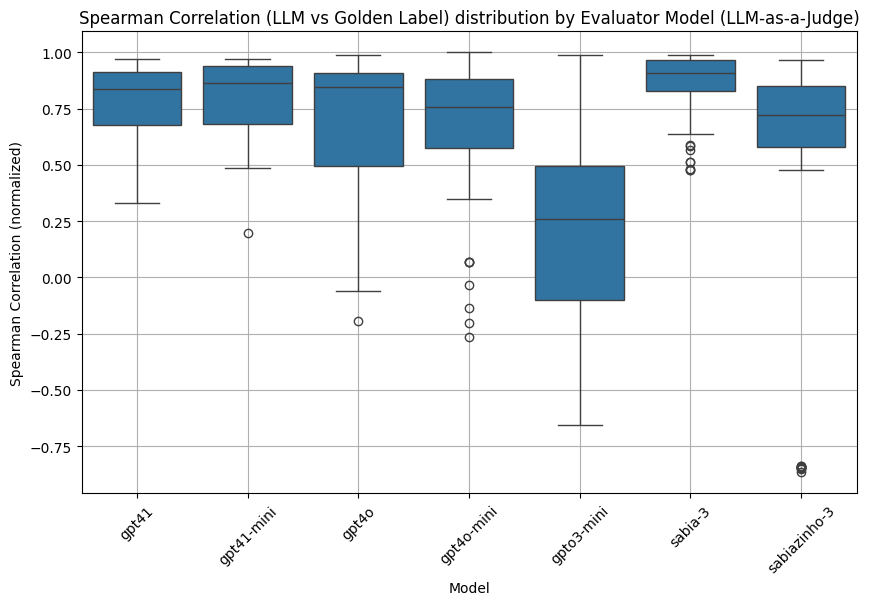

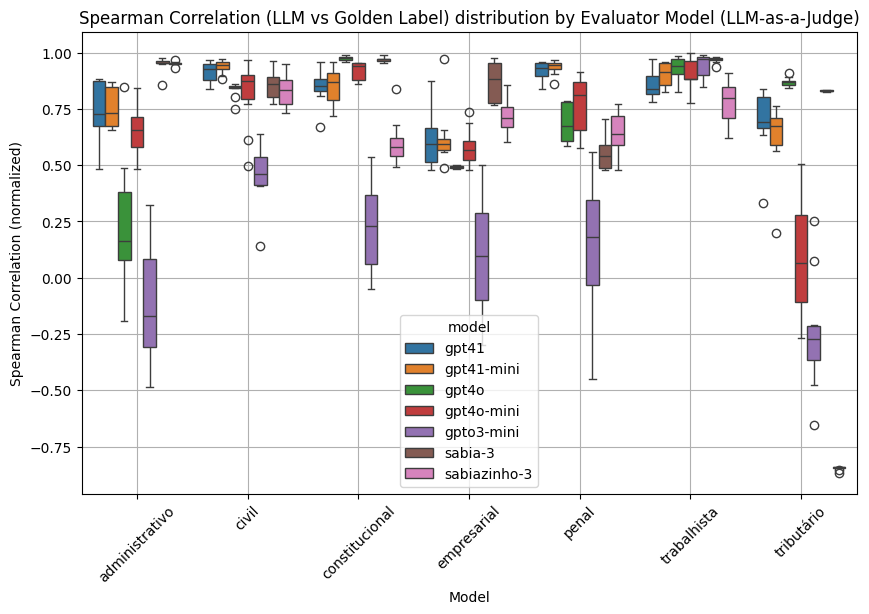

Summary of Cohen's Kappa:


,Mean,Median,Standard Deviation,95% CI Lower,95% CI Upper
model,,,,,
gpt41,0.676,0.689,0.066,0.666,0.687
gpt41-mini,0.683,0.694,0.067,0.672,0.693
gpt4o,0.794,0.805,0.051,0.786,0.802
gpt4o-mini,0.603,0.600,0.036,0.597,0.609
gpto3-mini,0.696,0.695,0.076,0.683,0.708
sabia-3,0.495,0.496,0.045,0.488,0.502
sabiazinho-3,0.558,0.558,0.035,0.552,0.564



Summary of Accuracy:


,Mean,Median,Standard Deviation,95% CI Lower,95% CI Upper
model,,,,,
gpt41,0.850,0.857,0.030,0.845,0.855
gpt41-mini,0.853,0.858,0.030,0.848,0.858
gpt4o,0.909,0.914,0.023,0.906,0.913
gpt4o-mini,0.809,0.808,0.018,0.806,0.812
gpto3-mini,0.876,0.874,0.030,0.871,0.881
sabia-3,0.740,0.741,0.027,0.735,0.744
sabiazinho-3,0.793,0.792,0.019,0.790,0.796


In [ ]:

# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_exp3, x='model', y='cohen_kappa')
plt.title("Cohen's Kappa (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Cohen's Kappa")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

plt.figure(figsize=(12, 8))
sns.boxplot(data=df_exp3, x='area', y='cohen_kappa', hue='model')
plt.title("Cohen's Kappa (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Cohen's Kappa")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot da Acurácia
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_exp2, x='model', y='accuracy')
plt.title("Accuracy (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Accuracy")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot da Acurácia
plt.figure(figsize=(12, 8))
sns.boxplot(data=df_exp3, x='area', y='accuracy', hue='model')
plt.title("Accuracy (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Accuracy")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()


# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='model', y='mae_normalized')
plt.title("Score MAE (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Score MAE (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='area', y='mae_normalized', hue='model')
plt.title("Score MAE (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Score MAE (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()


# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='model', y='pearson_corr')
plt.title("Pearson Correlation (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Pearson Correlation (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='area', y='pearson_corr', hue='model')
plt.title("Pearson Correlation (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Pearson Correlation (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='model', y='spearman_corr')
plt.title("Spearman Correlation (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Spearman Correlation (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_metricas, x='area', y='spearman_corr', hue='model')
plt.title("Spearman Correlation (LLM vs Golden Label) distribution by Evaluator Model (LLM-as-a-Judge)")
plt.ylabel("Spearman Correlation (normalized)")
plt.xlabel("Model")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Agora média, desvio padrão e IC95%
def resumo_estatistico(coluna):
    media = coluna.mean()
    desvio = coluna.std()
    mediana = coluna.median()
    n = len(coluna)
    erro_padrao = desvio / (n ** 0.5)
    intervalo = st.t.interval(0.95, n-1, loc=media, scale=erro_padrao)
    return pd.Series({
        'Mean': round(media,3),
        'Median': round(mediana,3),
        'Standard Deviation': round(desvio,3),
        '95% CI Lower': round(intervalo[0],3),
        '95% CI Upper': round(intervalo[1],3)
    })

# Aplicar para cada modelo e para cada métrica
resumo_kappa = df_exp2.groupby('model')['cohen_kappa'].apply(resumo_estatistico).unstack()
resumo_accuracy = df_exp2.groupby('model')['accuracy'].apply(resumo_estatistico).unstack()

# Exibir
print("Summary of Cohen's Kappa:")
display(resumo_kappa)

print("\nSummary of Accuracy:")
display(resumo_accuracy)



1. Arrumar os outros modelos;
2. Experimento para tamanho do colegiado (fazendo voto majoritário); 
3. Fazer a comparação com as questões objetivas de múltipla escolha.
4. Fazer para escrita da peça


### Escrita da peça

In [ ]:

# Caminho da pasta onde estão os arquivos de anotações
folder_path = "./data/"
file1_path = os.path.join(folder_path, "humano1_anotacoes_praticas.json")
file2_path = os.path.join(folder_path, "humano2_anotacoes_praticas.json")
file3_path = os.path.join(folder_path, "humano3_anotacoes_praticas.json")


# Função para carregar as anotações
def load_annotations(file_path):
    with open(file_path, "r", encoding="utf-8") as file:
        return json.load(file)

# Carregar os arquivos
annotations1 = load_annotations(file1_path)
annotations2 = load_annotations(file2_path)
annotations3 = load_annotations(file3_path)

# Criar um conjunto de todos os critérios avaliados
criteria_set = set()

# Transformar anotações em formato binário corretamente
annotations_bin1 = {}
annotations_bin2 = {}
annotations_bin3 = {}


for question_id, criteria in annotations1.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin1[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin1[f"{criterion}_0"] = 1 if answer == "Não" else 0

for question_id, criteria in annotations2.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin2[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin2[f"{criterion}_0"] = 1 if answer == "Não" else 0

for question_id, criteria in annotations3.items():
    for criterion, answer in criteria.items():
        criteria_set.add(criterion)
        annotations_bin3[f"{criterion}_1"] = 1 if answer == "Sim" else 0
        annotations_bin3[f"{criterion}_0"] = 1 if answer == "Não" else 0

# Criar conjuntos para o diagrama de Venn
set1 = {k for k, v in annotations_bin1.items() if v == 1}
set2 = {k for k, v in annotations_bin2.items() if v == 1}
set3 = {k for k, v in annotations_bin3.items() if v == 1}
all_possible = {f"{criterion}_1" for criterion in criteria_set} | {f"{criterion}_0" for criterion in criteria_set}

# Itens que não foram respondidos por ninguém
answered = set1 | set2 | set3
non_answered = all_possible - answered

# Contabilizar respostas da interseção (consenso entre avaliadores)
consensus= len(set1 & set2 &set3)


In [97]:

df_human_answers = pd.DataFrame(columns=['humano','exame','area','numero','parte','avaliacao'])
for ix, specific_set in enumerate([set1,set2,set3]):
    for row in specific_set:
        r = row.split("_")
        case = {'humano':[ix], 'exame':[r[1]],'area':[r[3]],'numero':[r[6]],'parte':[r[8]], 'avaliacao':[r[9]] }

        df_human_answers = pd.concat([df_human_answers, pd.DataFrame(case)
                                    ], ignore_index=True)

df_human_answers_ordered = df_human_answers.sort_values(by=['humano','exame','area','numero','parte'])
df_human_answers_h0 = df_human_answers_ordered.query('humano == 0')
df_human_answers_h1 = df_human_answers_ordered.query('humano == 1')
df_human_answers_h2 = df_human_answers_ordered.query('humano == 2')
evaluations_h0 = list(df_human_answers_h0['avaliacao'])
evaluations_h1 = list(df_human_answers_h1['avaliacao'])
evaluations_h2 = list(df_human_answers_h2['avaliacao'])

In [98]:
from statsmodels.stats.inter_rater import fleiss_kappa
import scipy.stats as stats
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Converte para números inteiros
avaliador1 = list(map(int, evaluations_h0))
avaliador2 = list(map(int, evaluations_h1))
avaliador3 = list(map(int, evaluations_h2))

# Junta as respostas por questão
respostas = list(zip(avaliador1, avaliador2, avaliador3))

# Para cada questão, conta quantos votaram 0 e quantos votaram 1
data = []
for resposta in respostas:
    votos_0 = resposta.count(0)
    votos_1 = resposta.count(1)
    data.append([votos_0, votos_1])

data = np.array(data)

# Calcula o Fleiss' Kappa
kappa = fleiss_kappa(data)

#print("Matriz de votos:")
#print(data)
print(f"Fleiss' Kappa: {kappa}")


Fleiss' Kappa: 0.7625396825396825


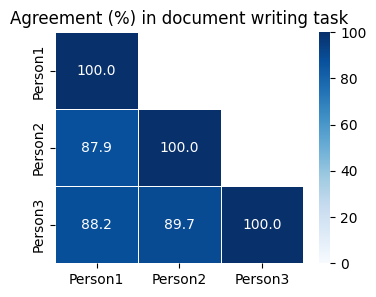

In [99]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Converta para np.array para facilitar
avaliadores = [
    np.array(avaliador1, dtype=int),
    np.array(avaliador2, dtype=int),
    np.array(avaliador3, dtype=int)
]

n = len(avaliadores)

# Matriz para guardar a % de concordância
matriz_concordancia = np.zeros((n, n))

# Calcula a % de concordância par a par
for i in range(n):
    for j in range(n):
        iguais = avaliadores[i] == avaliadores[j]
        matriz_concordancia[i, j] = np.mean(iguais) * 100  # porcentagem de acerto

# Converte para DataFrame
df_concordancia = pd.DataFrame(matriz_concordancia, 
                               index=[f"Person{i+1}" for i in range(n)], 
                               columns=[f"Person{i+1}" for i in range(n)])

# Cria máscara para a parte superior da matriz
mask = np.triu(np.ones_like(df_concordancia, dtype=bool), k=1)

# Plot
plt.figure(figsize=(4, 3))
sns.heatmap(df_concordancia, annot=True, fmt=".1f", cmap="Blues", 
            vmin=0, vmax=100, mask=mask, cbar=True, square=False, linewidths=0.5)
plt.title('Agreement (%) in document writing task')
plt.show()


In [103]:
assert len(avaliador1) == len(avaliador2) == len(avaliador3)

In [104]:
golden_labels = []
for i in range(len(avaliador1)):
    label = 1 if avaliador1[i]+avaliador2[i]+avaliador3[i] >= 2 else 0
    golden_labels.append(label)

In [105]:
golden_labels[0:20]

[1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 1, 0, 0, 0]

In [106]:
# Remove o campo 'humano' dos três DataFrames
df_h0 = df_human_answers_h0.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_1'})
df_h1 = df_human_answers_h1.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_2'})
df_h2 = df_human_answers_h2.drop(columns=['humano']).rename(columns={'avaliacao': 'avaliacao_3'})

# Faz o merge
df_human_human_answers2 = df_h0.merge(df_h1, on=['exame', 'area', 'numero', 'parte'], how='inner') \
                 .merge(df_h2, on=['exame', 'area', 'numero', 'parte'], how='inner')
for ix, row in df_human_human_answers2.iterrows():
    df_human_human_answers2.at[ix, 'golden_label'] = '1' if int(row['avaliacao_1']) + int(row['avaliacao_2']) + int(row['avaliacao_3']) >= 2 else '0'


In [107]:
df_human_human_answers2

,exame,area,numero,parte,avaliacao_1,avaliacao_2,avaliacao_3,golden_label
0,39,administrativo,1,I,1,1,1,1
1,39,administrativo,1,II,0,0,0,0
2,39,administrativo,10,I,0,0,0,0
3,39,administrativo,10,II,0,0,0,0
4,39,administrativo,10,III,0,0,0,0
...,...,...,...,...,...,...,...,...
556,41,tributário,7,I,1,1,1,1
557,41,tributário,8,I,1,0,1,1
558,41,tributário,8,II,0,0,0,0
559,41,tributário,9,I,1,1,1,1


Adaptar para funcionar essa bodega

In [72]:
def corrigir_avaliacao(formated_criteria, evaluation):
    #print('Entrou no corrigir')
    
    # Remove entradas sem número ou parte
    evaluation = [
        item for item in evaluation 
        if item.get('numero') is not None and item.get('parte') is not None
    ]
    
    # Coleta os pares (numero, parte) que já foram avaliados
    avaliados = {(item['numero'], item['parte']) for item in evaluation}
    #print('Pegou avaliados')

    #faltantes = 0

    for criterio in formated_criteria:
        chave = (criterio['numero'], criterio['parte'])

        if chave not in avaliados:
            novo_item = criterio.copy()
            novo_item['acerto'] = -1
            novo_item['raciocinio'] = 'Critério não avaliado pelo modelo ou falha em representar a estrutura.'
            evaluation.append(novo_item)
            #faltantes += 1
            print(f"[ADICIONADO] Critério {chave} foi incluído com acerto = -1")

    return evaluation


In [108]:
exams = df_document_writing['exam'].unique()
areas = df_document_writing['area'].unique()
models = df_document_writing['judge_model'].unique()
#models  = ['sabiazinho-3']

df_model_scores = pd.DataFrame(columns=['model','scores'])
df_model_answers = pd.DataFrame(columns=['model','experiment','judge','exam', 'area', 'number', 'parte','evaluation','score'])

last_case =''
last_context = []
try:
    for model in models:
        
        print(f'Evaluation {model}')
        for experiment in range(0,10):
             for judge in range(0,5):
                exam_score = 0
                for exam in exams:
                    for area in areas:
                        for number in range(1,2):
                            model_scores  = []
                            for ix, row in df_document_writing.query('exam == @exam & area == @area & judge_model == @model  & judge_number == @judge & experiment == @experiment').iterrows():
                                evaluation = row.evaluation
                                if 'resultado' in evaluation:
                                    evaluation = evaluation['resultado']
                                evaluation = corrigir_avaliacao(row.formated_criteria, evaluation)
                                print('---------------')
                                print(f'exp {experiment} judge {judge} exam {exam} number {number}' )
   
                                last_context = evaluation
                                # treatment to points
                                if 'pontos' not in evaluation[0]: #so the we need to take the scoring points in reference
                                    print('Não tem pontos na avaliação, corrigindo...')
                                    for e in evaluation:
                                        last_case = e
                                        if 'parte' not in e or 'acerto' not in e:
                                            print('Sem parte')
                                            print(z)
                                            continue
                                        print('NUMERO A')
                                        e_numero = e['numero']
                                        e_parte = e['parte']
                                        #now we need to find this question in reference
                                        for c in row.formated_criteria:
                                            print('NUMERO B')
                                            c_numero = c['numero']
                                            c_parte = c['parte']
                                            if e_numero == c_numero and e_parte == c_parte:
                                                #ok, we found the match, so we need to extract the points
                                                print('Corrigido!')
                                                e['pontos'] = c['pontos']
                                for z in evaluation:
                                    last_case = z
                                    print('entrou nas avaliações (caminho normal)')
                                    if 'parte' not in z or 'acerto' not in z:
                                        print('Sem parte ou acerto')
                                        print(z)
                                        continue
                                    print('NUMERO C')
    
                                    z_numero = z['numero']
                                    z_parte = z['parte']
                                    z_acerto = z['acerto']
                                    if 'pontos'  in z:
                                        z_pontos = z['pontos']
                                    else:
                                        z_pontos = 0
                                    #print(z_letra, z_parte, z_acerto, z_pontos)
                                    print('gravando caso...')
                                    print(f' numero {z_numero} parte {z_parte} acerto {z_acerto} pontos {z_pontos}')
                                    df_model_answers = pd.concat([df_model_answers, pd.DataFrame({'model':[model],'experiment':[experiment],'judge':[judge],'exam':[exam],'area':[area],'number':[z_numero],'parte':[z_parte],'evaluation':[z_acerto],'score':[z_pontos]})], ignore_index=True)
                                    print('gravou caso!')
except Exception as e:
    print('ERRO ',e)
    

Evaluation gpt4o-mini
---------------
exp 0 judge 0 exam 41 number 1
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 1 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 2 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 3 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 4 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 5 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 5 parte II acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 5.1 parte I acerto 1 pontos 0.1
gravou caso!
entrou nas avaliações (caminho normal)
NUMERO C
gravando caso...
 numero 5.1 parte II acerto 1 pontos 0.1
gravou cas

In [19]:
df_model_answers.to_pickle('respostas_escrita_peca.pkl')

In [109]:
print(len(df_model_answers))

197457


In [ ]:
df_model_answers = pd.read_pickle('respostas_escrita_peca.pkl')

In [110]:
df_model_answers['model'].value_counts()

model
gpto3-mini      29139
sabiazinho-3    28062
gpt4o-mini      28056
gpt41-mini      28050
gpt4o           28050
gpt41           28050
sabia-3         28050
Name: count, dtype: int64

tratamento

In [111]:
partes_validas = ['I', 'II', 'III', 'IV', 'V', 'VI','VII','VIII','IX','X']
evaluations_validas = [-1,0,1]
df_model_answers2 = df_model_answers[df_model_answers['parte'].isin(partes_validas)]
df_model_answers2 = df_model_answers2[df_model_answers2['evaluation'].isin(evaluations_validas)]
df_model_answers2.drop_duplicates(['model','experiment','judge','exam','area','number','parte','evaluation'])
df_model_answers2['model'].value_counts()

model
gpto3-mini      29139
sabiazinho-3    28058
gpt4o-mini      28050
gpt41-mini      28050
gpt4o           28050
gpt41           28050
sabia-3         28050
Name: count, dtype: int64

In [ ]:
import pandas as pd

def fix_df(df, df2):
    """
    Garante que todas as combinações (exam, area, number, parte) presentes em df2 existam no df.
    Se estiver faltando, adiciona entrada no df com evaluation = -1.
    Os campos model, experiment e judge podem ser definidos como padrão ou passados como argumento.
    """
    # Renomeia colunas do df2 para bater com as do df
    model = df.iloc[0].model
    experiment = df.iloc[0].experiment
    judge = df.iloc[0].judge
    df2_renamed = df2.rename(columns={'exame': 'exam', 'numero': 'number'})

    # Colunas de referência
    ref_cols = ['exam', 'area', 'number', 'parte']

    # Gera chaves únicas
    df['key'] = df[ref_cols].astype(str).agg('|'.join, axis=1)
    df2_renamed['key'] = df2_renamed[ref_cols].astype(str).agg('|'.join, axis=1)

    # Identifica chaves do df2 (padrão ouro) que não existem no df (modelo)
    missing_keys = set(df2_renamed['key']) - set(df['key'])

    # Filtra registros faltantes no df
    missing_rows = df2_renamed[df2_renamed['key'].isin(missing_keys)][ref_cols].copy()

    # Adiciona colunas obrigatórias
    missing_rows['model'] = model
    missing_rows['experiment'] = experiment
    missing_rows['judge'] = judge
    missing_rows['evaluation'] = -1

    # Reorganiza colunas no mesmo formato de df
    missing_rows = missing_rows[['model', 'experiment', 'judge', 'exam', 'area', 'number', 'parte', 'evaluation']]

    # Junta com o df original
    df_corrigido = pd.concat([df.drop(columns='key'), missing_rows], ignore_index=True)

    return df_corrigido


In [199]:
#numero 9

MEXI AQUI

In [77]:
#antigo
def unifica_dfs(df,df2):
    # Primeiro, renomeie as colunas do df1 para que coincidam com as do df2
    df1_renomeado = df.rename(columns={
        'exam': 'exame',
        'number': 'numero'
    })

    # Agora faça o merge com base nas colunas relevantes
    df_merged = df2.merge(
        df1_renomeado[['exame', 'area', 'numero', 'parte', 'evaluation','score']],
        on=['exame', 'area', 'numero', 'parte'],
        #how='left'
        how='inner'
    )


    # Converta explicitamente os tipos das colunas usadas no merge para garantir correspondência
    df['exam'] = df['exam'].astype(str)
    df['area'] = df['area'].astype(str)
    df['number'] = df['number'].astype(str)
    df['parte'] = df['parte'].astype(str)

    df2['exame'] = df2['exame'].astype(str)
    df2['area'] = df2['area'].astype(str)
    df2['numero'] = df2['numero'].astype(str)
    df2['parte'] = df2['parte'].astype(str)

    # Renomeie para facilitar o merge
    df1_renomeado = df.rename(columns={'exam': 'exame', 'number': 'numero'})

    # Faça o merge
    df_merged = df2.merge(
        df1_renomeado[['exame', 'area', 'numero', 'parte', 'evaluation','score']],
        on=['exame', 'area', 'numero', 'parte'],
        how='inner'
    )

    # Renomeie o campo final
    df_merged = df_merged.rename(columns={'evaluation': 'avaliacao_modelo'})
    df_merged['golden_label'] = df_merged['golden_label'].astype(int)
    df_merged['avaliacao_modelo'] = df_merged['avaliacao_modelo'].astype(int)
    return df_merged

In [76]:
#antigo
def unifica_dfs_practical(df,df2):
    # Primeiro, renomeie as colunas do df1 para que coincidam com as do df2
    df1_renomeado = df.rename(columns={
        'exam': 'exame',
        'number': 'numero'
    })

    # Agora faça o merge com base nas colunas relevantes
    df_merged = df2.merge(
        df1_renomeado[['exame', 'area', 'numero', 'parte', 'evaluation','score']],
        on=['exame', 'area', 'numero', 'parte'],
        #how='left'
        how='inner'
    )


    # Converta explicitamente os tipos das colunas usadas no merge para garantir correspondência
    df['exam'] = df['exam'].astype(str)
    df['area'] = df['area'].astype(str)
    df['number'] = df['number'].astype(str)
    df['parte'] = df['parte'].astype(str)
    df['experiment'] = df['experiment'].astype(str)
    df['judge'] = df['judge'].astype(str)

    df2['exame'] = df2['exame'].astype(str)
    df2['area'] = df2['area'].astype(str)
    df2['numero'] = df2['numero'].astype(str)
    df2['parte'] = df2['parte'].astype(str)

    # Renomeie para facilitar o merge
    df1_renomeado = df.rename(columns={'exam': 'exame', 'number': 'numero','score': 'potential_score','experiment':'experimento'})

    # Faça o merge
    df_merged = df2.merge(
        df1_renomeado[['model','experimento','judge','exame', 'area', 'numero', 'parte', 'evaluation','potential_score']],
        on=['exame', 'area', 'numero', 'parte'],
        how='inner'
    )

    # Renomeie o campo final
    df_merged = df_merged.rename(columns={'evaluation': 'avaliacao_modelo'})
    df_merged['golden_label'] = df_merged['golden_label'].astype(int)
    df_merged['avaliacao_modelo'] = df_merged['avaliacao_modelo'].astype(int)
    df_merged['score_by_golden_label'] =  df_merged['golden_label'] * df_merged['potential_score'] 
    df_merged['score_by_model'] =  df_merged['avaliacao_modelo'] * df_merged['potential_score'] 
    return df_merged

In [75]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
#antigo
from sklearn.metrics import cohen_kappa_score
experiments = list(range(10))
judges = range(5)
exams = range(39,42)

models = list(df_document_writing['judge_model'].unique())
#models.remove('sabia-3')
#models.remove('sabiazinho-3')
print('Processando')
df_exp2B = pd.DataFrame(columns = ['model','exam','experiment','judge','cohen_kappa','accuracy'])
for model in models:
    for exam in exams:
        for experiment in experiments:
            for judge in judges:
                #print(model, exam, experiment, judge)
                df = df_model_answers2.query('model == @model and judge == @judge and exam == @exam and experiment == @experiment').drop_duplicates()
                exam_s = str(exam)
                df2 = df_human_human_answers2.query('exame == @exam_s ')
                #print(len(df),len(df2))
                #if len(df) != len(df2): 
                #    df = fix_df(df,df2)
                #    print('tamanhos diferentes')
                #    if len(df) == 0:
                #        continue
                #print(len(df),len(df2))
                #df_ordered = df.sort_values(by=['exam','area','number','parte'])
                #df2_ordered = df2.sort_values(by=['exame','area','numero','parte'])
                #df_ordered['evaluation'] = df_ordered['evaluation'].astype(str)
                df_merged = unifica_dfs_practical(df,df2)
                accuracy= accuracy_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                cohen_kappa= cohen_kappa_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                #cohen_kappa = cohen_kappa_score(df2_ordered.golden_label, df_ordered.evaluation)
                df_exp2B = pd.concat([df_exp2B,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge], 'cohen_kappa':[cohen_kappa],'accuracy':[accuracy]}) ],ignore_index=True)

Processando


KeyError: "['score'] not in index"

In [78]:
#novo
from sklearn.metrics import cohen_kappa_score, accuracy_score
from sklearn.metrics import mean_squared_error, mean_absolute_error
from scipy.stats import pearsonr, spearmanr

experiments = list(range(10))
judges = range(5)
exams = range(39,42)
areas = list(df_discursive['area'].unique())
models = list(df_document_writing['judge_model'].unique())

df_all_scores_practical = pd.DataFrame(columns = ['exame', 'area', 'numero',  'parte', 'avaliacao_1',
       'avaliacao_2', 'avaliacao_3', 'golden_label', 'model',
       'avaliacao_modelo', 'potential_score', 'score_by_golden_label','score_by_model'])

#models.remove('sabia-3')
#models.remove('sabiazinho-3')
print('Processando')
#df_exp2B = pd.DataFrame(columns = ['model','exam','experiment','judge','cohen_kappa','accuracy'])
df_exp2B = pd.DataFrame(columns = ['model','exam','experiment','judge','cohen_kappa','accuracy','score_spearman_corr','score_spearman_p','score_pearson_corr','score_pearson_p','score_mae'])
df_exp3B = pd.DataFrame(columns = ['model','exam','experiment','judge','area','cohen_kappa','accuracy'])

for model in models:
    print(model)
    for exam in exams:
        for experiment in experiments:
            for judge in judges:
                #print(model, exam, experiment, judge)
                df = df_model_answers2.query('model == @model and judge == @judge and exam == @exam and experiment == @experiment').drop_duplicates()
                exam_s = str(exam)
                df2 = df_human_human_answers2.query('exame == @exam_s ')
                #print(f'DF1 {df.columns}\n DF2 {df2.columns}' )
                #print(len(df),len(df2))
                #if len(df) != len(df2): 
                #    df = fix_df(df,df2)
                #    print('tamanhos diferentes')
                #    if len(df) == 0:
                #        continue
                #print(len(df),len(df2))
                #df_ordered = df.sort_values(by=['exam','area','number','parte'])
                #df2_ordered = df2.sort_values(by=['exame','area','numero','parte'])
                #df_ordered['evaluation'] = df_ordered['evaluation'].astype(str)
                df_merged = unifica_dfs_practical(df,df2)
                df_all_scores_practical = pd.concat([df_all_scores_practical, df_merged],ignore_index=True)
                accuracy= accuracy_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                cohen_kappa= cohen_kappa_score(df_merged.golden_label, df_merged.avaliacao_modelo)
                pearson_corr, pearson_p = pearsonr(df_merged['score_by_golden_label'], df_merged['score_by_model'])
                spearman_corr, spearman_p = spearmanr(df_merged['score_by_golden_label'], df_merged['score_by_model'])
                score_mae = mean_absolute_error(df_merged['score_by_golden_label'], df_merged['score_by_model'])

                #cohen_kappa = cohen_kappa_score(df2_ordered.golden_label, df_ordered.evaluation)
                #df_exp2B = pd.concat([df_exp2B,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge], 'cohen_kappa':[cohen_kappa],'accuracy':[accuracy]}) ],ignore_index=True)
                df_exp2B = pd.concat([df_exp2B,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge], 'cohen_kappa':[cohen_kappa],'accuracy':[accuracy],
                'score_spearman_corr': [spearman_corr],'score_spearman_p': [spearman_p],
                'score_pearson_corr': [pearson_corr], 'score_pearson_p': [pearson_p],
                'score_mae': [score_mae]}) ],ignore_index=True)
                for area in areas:
                    df_practical_area = df_merged.query("area == @area")
                    accuracy_area= accuracy_score(df_practical_area.golden_label, df_practical_area.avaliacao_modelo)
                    cohen_kappa_area = cohen_kappa_score( df_practical_area.golden_label,  df_practical_area.avaliacao_modelo)
                    pearson_corr, pearson_p = pearsonr(df_practical_area['score_by_golden_label'], df_practical_area['score_by_model'])
                    spearman_corr, spearman_p = spearmanr(df_practical_area['score_by_golden_label'], df_practical_area['score_by_model'])
                    score_mae = mean_absolute_error(df_practical_area['score_by_golden_label'], df_practical_area['score_by_model'])
                    df_exp3B = pd.concat([df_exp3B,pd.DataFrame({'model':[model], 'exam': [exam], 'experiment': [experiment], 'judge':[judge],'area':[area], 'cohen_kappa':[cohen_kappa_area],'accuracy':[accuracy_area],
                    'score_spearman_corr': [spearman_corr],'score_spearman_p': [spearman_p],
                    'score_pearson_corr': [pearson_corr], 'score_pearson_p': [pearson_p],
                    'score_mae': [score_mae]}) ],ignore_index=True)

Processando
gpt4o-mini
gpt4o
gpt41-mini
gpt41
sabiazinho-3
sabia-3
gpto3-mini


In [79]:
df_practical_scores = pd.DataFrame(columns=['model','exame','area','experimento','judge','score_by_golden_label', 'score_by_model','normalized_score_by_golden_label','normalized_score_by_model'])
all = df_all_scores_practical.groupby(['model','exame','area','experimento','judge'])[['score_by_golden_label', 'score_by_model']].sum()
for index, row in all.iterrows():
    model, exame, area, experimento, judge = index  # descompacta os índices do grupo
    score_golden = row['score_by_golden_label']
    score_model = row['score_by_model']
    normalized_score_golden = score_golden *20
    normalized_score_model = score_golden *20
    df_practical_scores = pd.concat([df_practical_scores, pd.DataFrame([{
    'model': model,
    'exame': exame,
    'area': area,
    'experimento': experimento,
    'judge': judge,
    'score_by_golden_label': score_golden,
    'score_by_model': score_model,
    'normalized_score_by_golden_label': score_golden *20,  
    'normalized_score_by_model': score_model *20
}])], ignore_index=True)


In [80]:
from sklearn.metrics import mean_absolute_error
from scipy.stats import pearsonr, spearmanr
import pandas as pd

# DataFrame de saída
df_metricas_practical = pd.DataFrame(columns=[
    'model', 'area', 'experimento',
    'mae_normalized',
    'pearson_corr', 'pearson_pvalue',
    'spearman_corr', 'spearman_pvalue'
])

# Agrupamento por model, area, experimento
agrupado = df_practical_scores.groupby(['model', 'area', 'experimento'])

for (model, area, experimento), grupo in agrupado:
    # Extrai os vetores normalizados
    golden_scores = grupo['normalized_score_by_golden_label'].astype(float)
    model_scores = grupo['normalized_score_by_model'].astype(float)

    # Calcula as métricas
    mae = mean_absolute_error(golden_scores, model_scores)
    pearson_corr, pearson_p = pearsonr(golden_scores, model_scores)
    spearman_corr, spearman_p = spearmanr(golden_scores, model_scores)

    # Adiciona à tabela de resultados
    df_metricas_practical = pd.concat([df_metricas_practical, pd.DataFrame([{
        'model': model,
        'area': area,
        'experimento': experimento,
        'mae_normalized': mae,
        'pearson_corr': pearson_corr,
        'pearson_pvalue': pearson_p,
        'spearman_corr': spearman_corr,
        'spearman_pvalue': spearman_p
    }])], ignore_index=True)

In [81]:
df_objective = pd.read_pickle('respostas_objetivas_com_area.pkl')

In [82]:
def first_phase_score_area(df,area,model, exam):
    print(area, model)
    areas = dict_areas[area]

    df_area = df.query("area in @areas and model == @model and exam == @exam  ")
    qtd = len(df_area)
    print(qtd)
    acertos = len(df_area.query("model_answer == answer"))
    score = acertos/qtd *100
    return round(score,2)
    

In [83]:
def target_score_area(df,area, model, exam):
    exam= str(exam)
    df_area = df.query("area == @area  and model == @model and exame == @exam ")
    score = df_area['normalized_score_by_golden_label'].mean()
    return round(score,2)

In [84]:
def second_phase_score_area(df,area, model, exam):

    exam= str(exam)
    df_area = df.query("area == @area and model == @model and  exame == @exam ")
    score = df_area['normalized_score_by_model'].mean()
    return round(score,2)

In [85]:
dict_areas =  {'civil': ['civil','processo sivil'],
               'penal': ['penal','processo penal'],
               'trabalhista' : ['trabalho','processo do trabalho'],
               'tributário': ['tributario'],
               'administrativo': ['administrativo'],
               'constitucional': ['constitucional'],
               'empresarial': ['empresarial']
               }

In [86]:
dict_models = {'gpt4o':'gpt_4o', 'gpt4o-mini':  'gpt_4o_mini', 'gpto3-mini':'gpt_o3_mini',  'sabiazinho-3' :'sabiazinho3','sabia-3' : 'sabia3', 'gpt41': 'gpt_41', 'gpt41-mini':   'gpt_41_mini'    }

In [87]:
df_proxy_experiment_practical = pd.DataFrame(columns=['model','exam','area','first_phase','document_writing','target'])
exames = [e for e in  list(df_objective['exam'].unique()) if e in list(df_document_writing['exam'].unique())]
print(exames)
for area in list(df_document_writing['area'].unique()):
    for model in list(df_document_writing['judge_model'].unique()):
        for exame in exames:
            print(model, area)
            print(dict_models[model])
            first_phase = first_phase_score_area(df_objective,area,dict_models[model], exame)
            second_phase = second_phase_score_area(df_practical_scores ,area,model, exame)
            target = target_score_area(df_practical_scores ,area,model, exame)
            df_proxy_experiment_practical = pd.concat([df_proxy_experiment_practical, pd.DataFrame({'model': [model],'exam': [exame],'area':[area], 'first_phase': [first_phase], 'document_writing': [second_phase], 'target': [target]})],ignore_index=True)
df_proxy_experiment_practical.sample(3)

[41, 40]
gpt4o-mini administrativo
gpt_4o_mini
administrativo gpt_4o_mini
5
gpt4o-mini administrativo
gpt_4o_mini
administrativo gpt_4o_mini
5
gpt4o administrativo
gpt_4o
administrativo gpt_4o
5
gpt4o administrativo
gpt_4o
administrativo gpt_4o
5
gpt41-mini administrativo
gpt_41_mini
administrativo gpt_41_mini
5
gpt41-mini administrativo
gpt_41_mini
administrativo gpt_41_mini
5
gpt41 administrativo
gpt_41
administrativo gpt_41
5
gpt41 administrativo
gpt_41
administrativo gpt_41
5
sabiazinho-3 administrativo
sabiazinho3
administrativo sabiazinho3
5
sabiazinho-3 administrativo
sabiazinho3
administrativo sabiazinho3
5
sabia-3 administrativo
sabia3
administrativo sabia3
5
sabia-3 administrativo
sabia3
administrativo sabia3
5
gpto3-mini administrativo
gpt_o3_mini
administrativo gpt_o3_mini
5
gpto3-mini administrativo
gpt_o3_mini
administrativo gpt_o3_mini
5
gpt4o-mini civil
gpt_4o_mini
civil gpt_4o_mini
6
gpt4o-mini civil
gpt_4o_mini
civil gpt_4o_mini
6
gpt4o civil
gpt_4o
civil gpt_4o
6
gpt

,model,exam,area,first_phase,document_writing,target
48,gpt41,41,empresarial,75.00,61.00,41.0
65,sabiazinho-3,40,penal,75.00,14.64,48.0
23,sabiazinho-3,40,civil,83.33,54.26,64.0


In [88]:
import pandas as pd
import numpy as np
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, accuracy_score
from sklearn.linear_model import LinearRegression
from pingouin import intraclass_corr

# DataFrame final com area incluída
df_proxy_experiment_practical_scores = pd.DataFrame(columns=[
    'model', 'area',
    'mean_first_phase', 'mean_document_writing', 'mean_target',
    'mae_first_phase', 'mae_document_writing',
    'rmse_first_phase', 'rmse_document_writing',

])


# Iteração por modelo e área
for (model, area), group in df_proxy_experiment_practical.groupby(['model', 'area']):
    x1 = group['first_phase'].values.reshape(-1, 1)
    x2 = group['document_writing'].values.reshape(-1, 1)
    y = group['target'].values


    df_proxy_experiment_practical_scores = pd.concat([df_proxy_experiment_practical_scores, pd.DataFrame({
        'model': [model],
        'area': [area],
        'mean_first_phase': [round(np.mean(group['first_phase']),2)],
        'mean_document_writing': [round(np.mean(group['document_writing']),2)],
        'mean_target': [round(np.mean(group['target']),2)],
        'mae_first_phase': [round(mean_absolute_error(y, group['first_phase']),2)],
        'mae_document_writing': [round(mean_absolute_error(y, group['document_writing']),2)],
        'rmse_first_phase': [round(np.sqrt(mean_squared_error(y, group['first_phase'])),2)],
        'rmse_document_writing': [round(np.sqrt(mean_squared_error(y, group['document_writing'])),2)],
    })], ignore_index=True)
    #print(round(np.sqrt(mean_squared_error(y, group['first_phase'])),2))


In [89]:
df_proxy_experiment_practical_scores.groupby(['model'])[['mean_first_phase','mean_document_writing','mean_target','mae_first_phase','mae_document_writing','rmse_first_phase','rmse_document_writing']].mean()

,mean_first_phase,mean_document_writing,mean_target,mae_first_phase,mae_document_writing,rmse_first_phase,rmse_document_writing
model,,,,,,,
gpt41,70.715714,43.197143,46.571429,26.715714,19.008571,32.388571,20.250000
gpt41-mini,79.761429,43.345714,46.571429,33.190000,19.302857,37.302857,20.457143
gpt4o,85.475714,40.164286,46.571429,38.904286,19.110000,42.737143,20.797143
gpt4o-mini,64.642857,52.910000,46.571429,20.071429,17.690000,21.435714,19.821429
gpto3-mini,66.072857,29.024286,46.571429,21.501429,22.095714,23.904286,25.590000
sabia-3,76.428571,51.738571,46.571429,33.857143,21.055714,37.235714,23.534286
sabiazinho-3,69.287143,39.842857,46.571429,23.144286,22.154286,25.850000,24.230000


In [90]:
df_proxy_experiment_practical_scores.query('model == "gpt4o"')

,model,area,mean_first_phase,mean_document_writing,mean_target,mae_first_phase,mae_document_writing,rmse_first_phase,rmse_document_writing
14,gpt4o,administrativo,90.00,37.46,52.5,37.50,15.04,42.74,16.57
15,gpt4o,civil,75.00,43.84,51.0,24.00,10.16,32.11,12.43
16,gpt4o,constitucional,75.00,39.95,32.0,43.00,20.53,45.65,22.02
17,gpt4o,empresarial,100.00,45.26,54.0,46.00,17.18,47.80,19.28
18,gpt4o,penal,83.33,34.50,46.5,36.83,12.00,36.86,14.42
19,gpt4o,trabalhista,85.00,43.32,44.0,41.00,38.68,47.51,38.69
20,gpt4o,tributário,90.00,36.82,46.0,44.00,20.18,46.49,22.17


In [91]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, accuracy_score, mean_absolute_error, mean_squared_error

# DataFrame de saída
df_proxy_experiment_practical_scores_univariate_regression = pd.DataFrame(columns=[
    'model',
    'r2_first_phase', 'r2_document_writing', 'coef_first_phase', 'coef_document_writing', 'mae_first_phase',  'mae_document_writing',  'rmse_first_phase',
     'rmse_document_writing'
])

# Itera por modelo
for model, group in df_proxy_experiment_practical_scores.groupby('model'):
    x1 = group['mean_first_phase'].values.reshape(-1, 1)
    x2 = group['mean_document_writing'].values.reshape(-1, 1)
    y = group['mean_target'].values

    # Regressão com primeira fase
    reg1 = LinearRegression().fit(x1, y)
    y_pred1 = reg1.predict(x1)

    # Regressão com segunda fase
    reg2 = LinearRegression().fit(x2, y)
    y_pred2 = reg2.predict(x2)

    # RMSE manual (sem `squared=False`)
    rmse1 = np.sqrt(mean_squared_error(y, y_pred1))
    rmse2 = np.sqrt(mean_squared_error(y, y_pred2))

    # Adiciona ao DataFrame
    df_proxy_experiment_practical_scores_univariate_regression = pd.concat([df_proxy_experiment_practical_scores_univariate_regression, pd.DataFrame({
        'model': [model],
        'r2_first_phase': [r2_score(y, y_pred1)],
        'r2_document_writing': [r2_score(y, y_pred2)],
        'coef_first_phase': [reg1.coef_[0]],
        'coef_document_writing': [reg2.coef_[0]],
        'mae_first_phase': [mean_absolute_error(y, y_pred1)],
        'mae_document_writing': [mean_absolute_error(y, y_pred2)],
        'rmse_first_phase': [rmse1],
        'rmse_document_writing': [rmse2],
    })], ignore_index=True)


In [93]:
df_proxy_experiment_practical_scores_univariate_regression 

,model,r2_first_phase,r2_document_writing,coef_first_phase,coef_document_writing,mae_first_phase,mae_document_writing,rmse_first_phase,rmse_document_writing
0,gpt41,0.018313,0.061082,0.069159,0.308534,5.067272,5.370961,6.794804,6.645139
1,gpt41-mini,0.076573,0.061769,0.176218,0.331316,4.837901,5.330428,6.590095,6.642709
2,gpt4o,0.366681,0.038090,0.503485,0.354005,4.136661,5.195468,5.457597,6.726009
3,gpt4o-mini,0.060940,0.001160,0.178788,-0.036933,4.764343,5.116034,6.645641,6.853908
4,gpto3-mini,0.192018,0.000630,-0.300965,0.044815,5.307049,5.042109,6.164404,6.855726
5,sabia-3,0.117641,0.015922,0.199356,0.084270,4.735220,5.192491,6.441886,6.803073
6,sabiazinho-3,0.066972,0.237711,0.275976,0.328451,4.890657,4.879593,6.624265,5.987564


In [92]:
import pandas as pd
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

# DataFrame de saída
df_proxy_experiment_practical_scores_bivariate_regression = pd.DataFrame(columns=[
    'model',
    'r2_combined', 'mae_combined', 'rmse_combined',
    'coef_first_phase', 'coef_document_writing'
])

# Itera por modelo
for model, group in df_proxy_experiment_practical_scores.groupby('model'):
    # Features combinadas: primeira e segunda fase
    X = group[['mean_first_phase', 'mean_document_writing']].values
    y = group['mean_target'].values

    # Regressão múltipla
    reg = LinearRegression().fit(X, y)
    y_pred = reg.predict(X)

    # RMSE
    rmse = np.sqrt(mean_squared_error(y, y_pred))

    # Adiciona ao DataFrame
    df_proxy_experiment_practical_scores_bivariate_regression = pd.concat([df_proxy_experiment_discursive_scores_bivariate_regression, pd.DataFrame({
        'model': [model],
        'r2_combined': [r2_score(y, y_pred)],
        'mae_combined': [mean_absolute_error(y, y_pred)],
        'rmse_combined': [rmse],
        'coef_first_phase': [reg.coef_[0]],
        'coef_document_writing': [reg.coef_[1]],
    })], ignore_index=True)


In [94]:
df_proxy_experiment_practical_scores_bivariate_regression

,model,r2_combined,mae_combined,rmse_combined,coef_first_phase,coef_discursive,coef_document_writing
0,gpt41,0.363722,4.419555,4.821163,0.009495,0.640907,NaN
1,gpt41-mini,0.437585,4.304493,4.532701,0.167185,0.508615,NaN
2,gpt4o,0.762818,2.294791,2.943537,-0.157130,0.959436,NaN
3,gpt4o-mini,0.348908,3.991765,4.876964,0.237437,0.379173,NaN
4,gpto3-mini,0.631688,2.709824,3.668061,0.005299,0.925917,NaN
5,sabia-3,0.309515,4.538754,5.022334,0.159373,0.320266,NaN
6,sabiazinho-3,0.275823,4.373567,5.077400,0.050127,0.296918,NaN
7,sabiazinho-3,0.308096,4.800835,5.704444,0.282945,NaN,0.330829


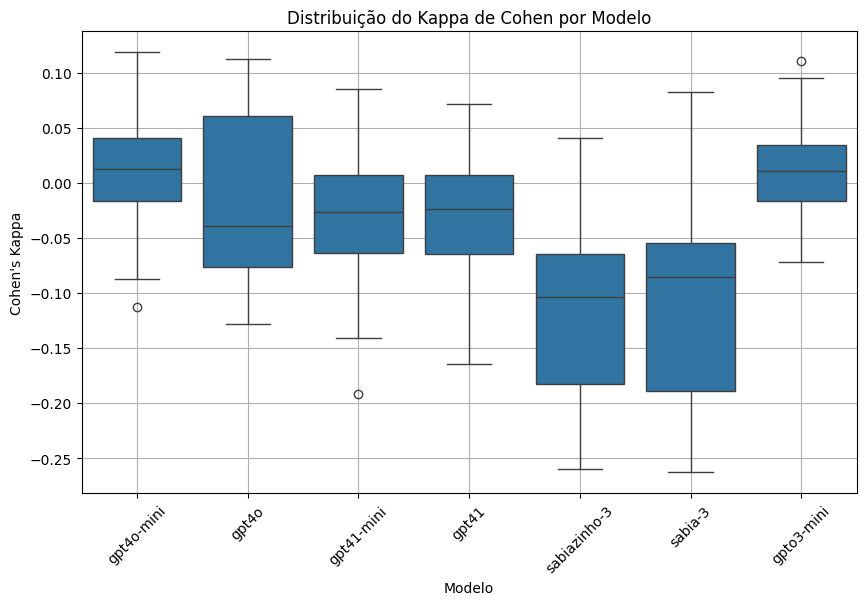

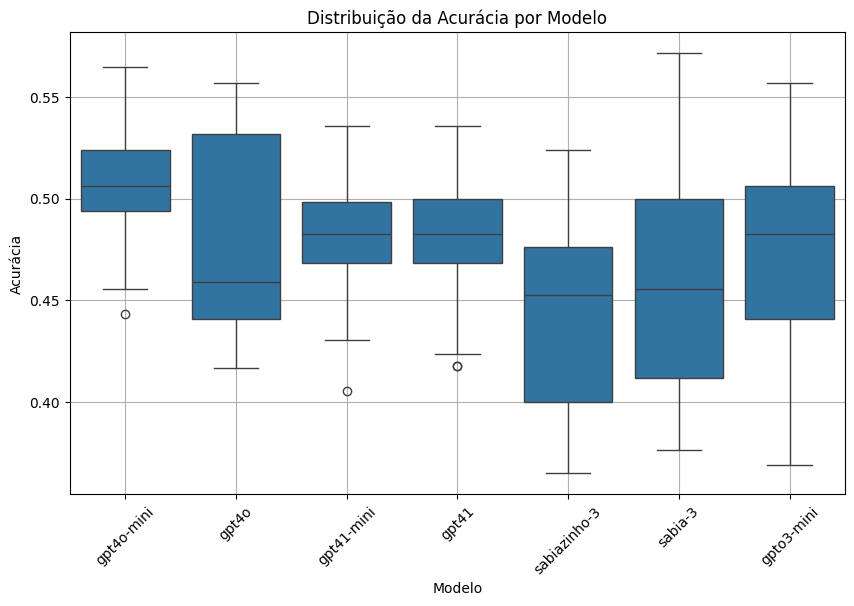

Resumo Estatístico do Cohen's Kappa:


,Média,Mediana,Desvio Padrão,IC95% Inferior,IC95% Superior
model,,,,,
gpt41,-0.028560,-0.023810,0.051783,-0.036915,-0.020205
gpt41-mini,-0.028966,-0.026345,0.050303,-0.037082,-0.020851
gpt4o,-0.015553,-0.039685,0.069850,-0.026823,-0.004284
gpt4o-mini,0.008104,0.012816,0.044160,0.000980,0.015229
gpto3-mini,0.013297,0.010309,0.038213,0.007131,0.019462
sabia-3,-0.110232,-0.085650,0.078463,-0.122892,-0.097573
sabiazinho-3,-0.117287,-0.103370,0.073427,-0.129134,-0.105440



Resumo Estatístico da Acurácia:


,Média,Mediana,Desvio Padrão,IC95% Inferior,IC95% Superior
model,,,,,
gpt41,0.481977,0.482353,0.024483,0.478026,0.485927
gpt41-mini,0.481986,0.482353,0.023421,0.478207,0.485765
gpt4o,0.477782,0.458824,0.044465,0.470608,0.484956
gpt4o-mini,0.508823,0.506329,0.025267,0.504747,0.512900
gpto3-mini,0.474865,0.482353,0.045384,0.467543,0.482188
sabia-3,0.456341,0.455696,0.049218,0.448400,0.464282
sabiazinho-3,0.438796,0.452381,0.041258,0.432140,0.445453


In [95]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as st



# Boxplot do Cohen's Kappa
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_exp2B, x='model', y='cohen_kappa')
plt.title("Distribuição do Kappa de Cohen por Modelo")
plt.ylabel("Cohen's Kappa")
plt.xlabel("Modelo")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Boxplot da Acurácia
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_exp2B, x='model', y='accuracy')
plt.title("Distribuição da Acurácia por Modelo")
plt.ylabel("Acurácia")
plt.xlabel("Modelo")
plt.xticks(rotation=45)
plt.grid()
plt.show()

# Agora média, desvio padrão e IC95%
def resumo_estatistico(coluna):
    media = coluna.mean()
    desvio = coluna.std()
    mediana = coluna.median()
    n = len(coluna)
    erro_padrao = desvio / (n ** 0.5)
    intervalo = st.t.interval(0.95, n-1, loc=media, scale=erro_padrao)
    return pd.Series({
        'Média': media,
        'Mediana': mediana,
        'Desvio Padrão': desvio,
        'IC95% Inferior': intervalo[0],
        'IC95% Superior': intervalo[1]
    })

# Aplicar para cada modelo e para cada métrica
resumo_kappa = df_exp2B.groupby('model')['cohen_kappa'].apply(resumo_estatistico).unstack()
resumo_accuracy = df_exp2B.groupby('model')['accuracy'].apply(resumo_estatistico).unstack()

# Exibir
print("Resumo Estatístico do Cohen's Kappa:")
display(resumo_kappa)

print("\nResumo Estatístico da Acurácia:")
display(resumo_accuracy)



Tamanho do colegiado

In [151]:
df_model_answers2.sample(2)

,model,experiment,judge,exam,area,number,parte,evaluation
20552,gpt4o-mini,1,4,41,constitucional,14,III,0
111530,gpt4o-mini,9,4,39,administrativo,13,I,0


In [152]:
df_model_answers2.columns

Index(['model', 'experiment', 'judge', 'exam', 'area', 'number', 'parte',
       'evaluation'],
      dtype='object')

In [153]:
df_human_human_answers2.sample(2)

,exame,area,numero,parte,avaliacao_1,avaliacao_2,avaliacao_3,golden_label
201,40,administrativo,7,II,0,0,0,0
518,41,trabalhista,12,I,1,1,1,1


In [154]:
df_human_human_answers2.columns

Index(['exame', 'area', 'numero', 'parte', 'avaliacao_1', 'avaliacao_2',
       'avaliacao_3', 'golden_label'],
      dtype='object')

In [162]:
df_sub

,model,experiment,judge,exam,area,number,parte,evaluation,chave
437604,gpt41,9,0,41,administrativo,1,I,1,41|administrativo|1|I
438089,gpt41,9,0,41,penal,5,I,1,41|penal|5|I
438090,gpt41,9,0,41,penal,5,II,0,41|penal|5|II
438091,gpt41,9,0,41,penal,5,III,0,41|penal|5|III
438092,gpt41,9,0,41,penal,6,I,1,41|penal|6|I
...,...,...,...,...,...,...,...,...,...
446848,gpt41,9,4,41,constitucional,1,I,0,41|constitucional|1|I
446849,gpt41,9,4,41,constitucional,2,I,1,41|constitucional|2|I
446850,gpt41,9,4,41,constitucional,2,II,0,41|constitucional|2|II
446852,gpt41,9,4,41,constitucional,4,I,1,41|constitucional|4|I


In [37]:
from sklearn.metrics import cohen_kappa_score, accuracy_score
from collections import Counter
import pandas as pd

experiments = list(range(10))
exams = list(range(39, 42))
models = list(df_model_answers2['model'].unique())
#models.remove('sabia-3')
#models.remove('sabiazinho-3')

colegiados = [1, 3, 5]
resultados = []

print('Processando colegiados...')

for model in models:
    for exam in exams:
        for experiment in experiments:
            for colegiado_size in colegiados:
                # Filtra as avaliações desse experimento e modelo
                df_sub = df_model_answers2.query(
                    'model == @model and experiment == @experiment and exam == @exam'
                ).drop_duplicates()

                # Garante ordenação por juiz para selecionar consistentemente
                df_sub = df_sub.sort_values(by='judge')

                # Seleciona apenas os juízes desejados para o colegiado
                df_sub = df_sub[df_sub['judge'] < colegiado_size]

                # Cria chave de agrupamento
                df_sub['chave'] = df_sub[['exam', 'area', 'number', 'parte']].astype(str).agg('|'.join, axis=1)
                df_sub['evaluation'] = df_sub['evaluation'].astype(int)
         
                # Agrupa por questão e aplica voto majoritário
                votos_majoritarios = (
                    df_sub.groupby('chave')['evaluation']
                    .apply(lambda x: Counter(x).most_common(1)[0][0])
                    .reset_index()
                    .rename(columns={'evaluation': 'avaliacao_modelo'})
                )

                # Recupera estrutura da chave
                votos_majoritarios[['exam', 'area', 'number', 'parte']] = votos_majoritarios['chave'].str.split('|', expand=True)
                votos_majoritarios.drop(columns='chave', inplace=True)

                # Converte tipos para merge
                votos_majoritarios['exam'] = votos_majoritarios['exam'].astype(int)
                votos_majoritarios['number'] = votos_majoritarios['number'].astype(str)
                votos_majoritarios['parte'] = votos_majoritarios['parte'].astype(str)

                # Carrega padrão ouro
                exam_s = str(exam)
                df_gold = df_human_human_answers2.query('exame == @exam_s')
                df_gold['exam'] = df_gold['exame'].astype(int)
                df_gold['number'] = df_gold['numero'].astype(str)
                df_gold['parte'] = df_gold['parte'].astype(str)

                # Faz merge
                df_merged = pd.merge(
                    votos_majoritarios,
                    df_gold,
                    on=['exam', 'area', 'number', 'parte'],
                    how='inner'
                )
                df_merged['avaliacao_modelo'] = df_merged['avaliacao_modelo'].astype(str)
                df_merged['golden_label'] = df_merged['golden_label'].astype(str)
                
                # Calcula métricas
                acc = accuracy_score(df_merged['golden_label'], df_merged['avaliacao_modelo'])
                kappa = cohen_kappa_score(df_merged['golden_label'], df_merged['avaliacao_modelo'])

                # Armazena
                resultados.append({
                    'model': model,
                    'exam': exam,
                    'experiment': experiment,
                    'colegiado': colegiado_size,
                    'accuracy': acc,
                    'cohen_kappa': kappa
                })

# Cria DataFrame final
df_resultados_colegiado = pd.DataFrame(resultados)


Processando colegiados...


In [38]:
from collections import Counter

def voto_majoritario(x):
    # x é uma série de respostas (0, 1 ou -1)
    # Primeiramente, desconsidera os votos -1
    votos_validos = [v for v in x if v != -1]
    
    # Se não houver votos válidos, retorne -1
    if not votos_validos:
        return -1
    
    contador = Counter(votos_validos)
    mais_comum = contador.most_common()
    
    # Se houver empate, ou seja, o voto mais comum tiver a mesma contagem do segundo
    if len(mais_comum) > 1 and mais_comum[0][1] == mais_comum[1][1]:
        # Nesse caso, retorna qualquer um (vamos retornar o primeiro)
        return mais_comum[0][0]
    else:
        return mais_comum[0][0]

# Trecho do código adaptado:
for model in models:
    for exam in exams:
        for experiment in experiments:
            for colegiado_size in colegiados:
                # Filtra as avaliações desse experimento e modelo
                df_sub = df_model_answers2.query(
                    'model == @model and experiment == @experiment and exam == @exam'
                ).drop_duplicates()

                # Garante ordenação por juiz para selecionar consistentemente
                df_sub = df_sub.sort_values(by='judge')

                # Seleciona apenas os juízes desejados para o colegiado
                df_sub = df_sub[df_sub['judge'] < colegiado_size]

                # Cria chave de agrupamento para cada questão
                df_sub['chave'] = df_sub[['exam', 'area', 'number', 'parte']].astype(str).agg('|'.join, axis=1)

                # Agrupa por questão e aplica voto majoritário usando a função definida
                votos_majoritarios = (
                    df_sub.groupby('chave')['evaluation']
                    .apply(voto_majoritario)
                    .reset_index()
                    .rename(columns={'evaluation': 'avaliacao_modelo'})
                )

                # Recupera a estrutura original da chave
                votos_majoritarios[['exam', 'area', 'number', 'parte']] = votos_majoritarios['chave'].str.split('|', expand=True)
                votos_majoritarios.drop(columns='chave', inplace=True)

                # Converte os tipos para realizar o merge
                votos_majoritarios['exam'] = votos_majoritarios['exam'].astype(int)
                votos_majoritarios['number'] = votos_majoritarios['number'].astype(str)
                votos_majoritarios['parte'] = votos_majoritarios['parte'].astype(str)

                # Prossegue com o merge e o cálculo das métricas como antes...
                # Faz merge
                df_merged = pd.merge(
                    votos_majoritarios,
                    df_gold,
                    on=['exam', 'area', 'number', 'parte'],
                    how='inner'
                )
                df_merged['avaliacao_modelo'] = df_merged['avaliacao_modelo'].astype(str)
                df_merged['golden_label'] = df_merged['golden_label'].astype(str)
                
                # Calcula métricas
                acc = accuracy_score(df_merged['golden_label'], df_merged['avaliacao_modelo'])
                kappa = cohen_kappa_score(df_merged['golden_label'], df_merged['avaliacao_modelo'])

                # Armazena
                resultados.append({
                    'model': model,
                    'exam': exam,
                    'experiment': experiment,
                    'colegiado': colegiado_size,
                    'accuracy': acc,
                    'cohen_kappa': kappa
                })

# Cria DataFrame final
df_resultados_colegiado = pd.DataFrame(resultados)

In [39]:
df_resultados_colegiado

,model,exam,experiment,colegiado,accuracy,cohen_kappa
0,gpt4o-mini,39,0,1,0.821622,0.645203
1,gpt4o-mini,39,0,3,0.800000,0.605907
2,gpt4o-mini,39,0,5,0.800000,0.605907
3,gpt4o-mini,39,1,1,0.772973,0.553346
4,gpt4o-mini,39,1,3,0.783784,0.573290
...,...,...,...,...,...,...
1075,sabia-3,41,8,3,0.602041,0.277436
1076,sabia-3,41,8,5,0.612245,0.285838
1077,sabia-3,41,9,1,0.530612,0.246532
1078,sabia-3,41,9,3,0.647959,0.346919


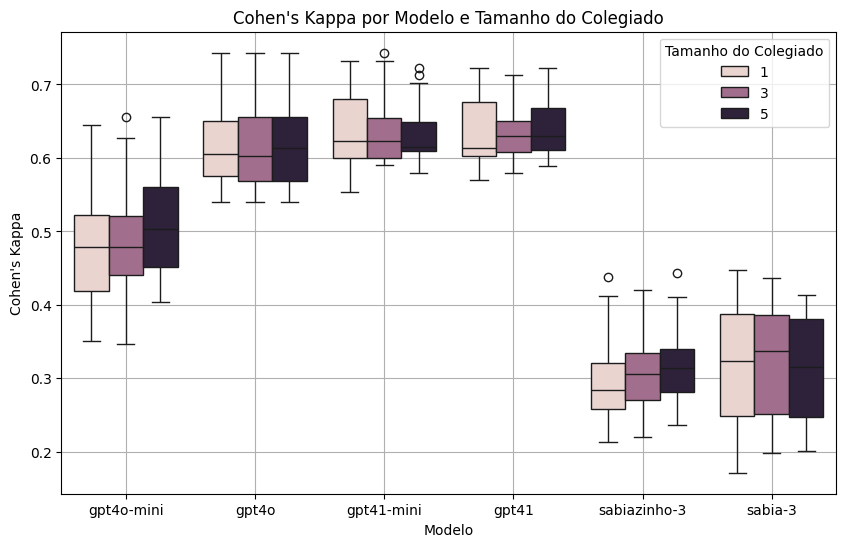

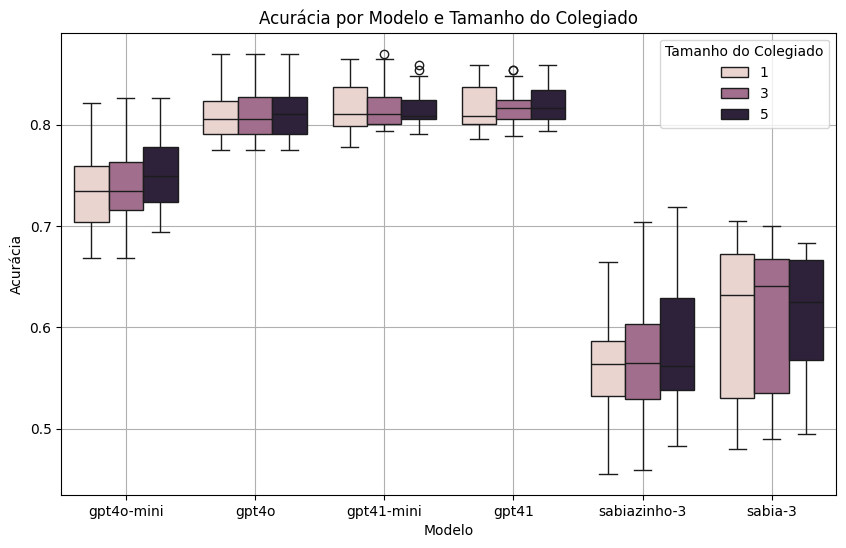

In [40]:
import seaborn as sns
import matplotlib.pyplot as plt

# Boxplot do Kappa de Cohen
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_resultados_colegiado, x='model', y='cohen_kappa', hue='colegiado')
plt.title("Cohen's Kappa por Modelo e Tamanho do Colegiado")
plt.xlabel("Modelo")
plt.ylabel("Cohen's Kappa")
plt.legend(title='Tamanho do Colegiado')
plt.grid()
plt.show()

# Boxplot da Acurácia
plt.figure(figsize=(10, 6))
sns.boxplot(data=df_resultados_colegiado, x='model', y='accuracy', hue='colegiado')
plt.title("Acurácia por Modelo e Tamanho do Colegiado")
plt.xlabel("Modelo")
plt.ylabel("Acurácia")
plt.legend(title='Tamanho do Colegiado')
plt.grid()
plt.show()


In [170]:
df_model_answers2

,model,experiment,judge,exam,area,number,parte,evaluation
0,gpt4o-mini,0,0,41,administrativo,1,I,1
1,gpt4o-mini,0,0,41,administrativo,2,I,1
2,gpt4o-mini,0,0,41,administrativo,3,I,1
3,gpt4o-mini,0,0,41,administrativo,4,I,1
4,gpt4o-mini,0,0,41,administrativo,5,I,1
...,...,...,...,...,...,...,...,...
449407,sabiazinho-3,0,0,41,penal,9,II,-1
449408,sabiazinho-3,0,0,41,penal,10,II,-1
449409,sabiazinho-3,0,0,41,penal,11,II,-1
449410,sabiazinho-3,0,0,41,penal,11,III,-1
